<a href="https://colab.research.google.com/github/gndedesmu/casestudy2/blob/main/Covid_19_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install geopandas

Import the Libraries

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import branca.colormap as cm
import folium
import geopandas as gpd
from shapely.geometry import Point, Polygon
import descartes
import warnings



In [ ]:
warnings.filterwarnings("ignore")
sns.set(style="darkgrid")
# Set the color palette
sns.set_palette(sns.color_palette("dark"))
pd.options.display.float_format = '{:.1f}'.format

Load the Dataset which can be downloaded by clicking [this link](https://covid.ourworldindata.org/data/owid-covid-data.csv)

In [ ]:
df = pd.read_csv("/content/owid_covid_data.csv")

df.tail()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,new_tests,total_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,tests_units,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,new_vaccinations_smoothed_per_million,stringency_index,population,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality
105719,ZWE,Africa,Zimbabwe,2021-07-24,97277.0,1591.0,2094.9,3050.0,89.0,66.0,6544.9,107.0,140.9,205.2,6.0,4.4,1.1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,2116664.0,1438890.0,677774.0,44604.0,49319.0,14.2,9.7,4.6,3318.0,nan,14862927.0,42.7,19.6,2.8,1.9,1899.8,21.4,307.8,1.8,1.6,30.7,36.8,1.7,61.5,0.6,nan
105720,ZWE,Africa,Zimbabwe,2021-07-25,97894.0,617.0,2039.3,3094.0,44.0,67.4,6586.5,41.5,137.2,208.2,3.0,4.5,1.1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,2127402.0,1447342.0,680060.0,10738.0,48838.0,14.3,9.7,4.6,3286.0,nan,14862927.0,42.7,19.6,2.8,1.9,1899.8,21.4,307.8,1.8,1.6,30.7,36.8,1.7,61.5,0.6,nan
105721,ZWE,Africa,Zimbabwe,2021-07-26,99944.0,2050.0,2030.3,3173.0,79.0,68.0,6724.4,137.9,136.6,213.5,5.3,4.6,1.1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,2178709.0,1491493.0,687216.0,51307.0,50153.0,14.7,10.0,4.6,3374.0,nan,14862927.0,42.7,19.6,2.8,1.9,1899.8,21.4,307.8,1.8,1.6,30.7,36.8,1.7,61.5,0.6,nan
105722,ZWE,Africa,Zimbabwe,2021-07-27,101711.0,1767.0,1899.4,3280.0,107.0,76.1,6843.3,118.9,127.8,220.7,7.2,5.1,1.1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,14862927.0,42.7,19.6,2.8,1.9,1899.8,21.4,307.8,1.8,1.6,30.7,36.8,1.7,61.5,0.6,nan
105723,ZWE,Africa,Zimbabwe,2021-07-28,103567.0,1856.0,1778.1,3340.0,60.0,75.9,6968.1,124.9,119.6,224.7,4.0,5.1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,NaN,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,14862927.0,42.7,19.6,2.8,1.9,1899.8,21.4,307.8,1.8,1.6,30.7,36.8,1.7,61.5,0.6,nan


In [ ]:
df.shape

(105724, 60)

Drop the unwanted Columns.

In [ ]:
#Drop unwanted columns 
df.drop(columns=['new_cases_smoothed', 'new_deaths_smoothed', 'new_cases_smoothed_per_million', 
                      'new_deaths_smoothed_per_million', 'reproduction_rate', 'weekly_icu_admissions_per_million', 
                      'weekly_hosp_admissions_per_million', 'new_tests', 'total_tests', 'total_tests_per_thousand', 
                      'new_tests_per_thousand', 'new_tests_smoothed', 'new_tests_smoothed_per_thousand', 'positive_rate', 
                      'tests_per_case', 'tests_units', 'new_vaccinations_smoothed', 'new_vaccinations_smoothed_per_million', 'aged_65_older', 
                      'aged_70_older','icu_patients','icu_patients_per_million','weekly_icu_admissions', 'cardiovasc_death_rate', 'diabetes_prevalence', 'female_smokers', 
                      'male_smokers', 'handwashing_facilities', 'life_expectancy','excess_mortality'], inplace=True) 

Check for missing Values:


In [ ]:
# Check for missing values
df.apply(lambda x: sum(x.isnull()),axis=0) 

iso_code                                    0
continent                                4912
location                                    0
date                                        0
total_cases                              4316
new_cases                                4319
total_deaths                            14637
new_deaths                              14482
total_cases_per_million                  4854
new_cases_per_million                    4857
total_deaths_per_million                15162
new_deaths_per_million                  15007
hosp_patients                           92424
hosp_patients_per_million               92424
weekly_hosp_admissions                 103844
total_vaccinations                      85985
people_vaccinated                       86853
people_fully_vaccinated                 89785
new_vaccinations                        89300
total_vaccinations_per_hundred          85985
people_vaccinated_per_hundred           86853
people_fully_vaccinated_per_hundre

Replace Missing Values with Zeros

In [ ]:
df.update(df[['continent','total_cases','new_cases','total_deaths','new_deaths','total_cases_per_million','new_cases_per_million','total_deaths_per_million',
              'new_deaths_per_million','hosp_patients','hosp_patients_per_million',
              'weekly_hosp_admissions','total_vaccinations','people_vaccinated','people_fully_vaccinated','new_vaccinations','total_vaccinations_per_hundred',
              'people_vaccinated_per_hundred','people_fully_vaccinated_per_hundred','gdp_per_capita','extreme_poverty', 'stringency_index','population','population_density','median_age',
              'hospital_beds_per_thousand','human_development_index']].fillna(0))


Rename Columns

In [ ]:
df = df.rename(columns={'location':'country'})


Inaccurate Data

In [ ]:
flt =(df['country'] == 'Asia')
df[flt].head()

,iso_code,continent,country,date,total_cases,new_cases,total_deaths,new_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population,population_density,median_age,gdp_per_capita,extreme_poverty,hospital_beds_per_thousand,human_development_index
4988,OWID_ASI,0,Asia,2020-01-22,556.0,0.0,17.0,0.0,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4639847425.0,0.0,0.0,0.0,0.0,0.0,0.0
4989,OWID_ASI,0,Asia,2020-01-23,654.0,98.0,18.0,1.0,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4639847425.0,0.0,0.0,0.0,0.0,0.0,0.0
4990,OWID_ASI,0,Asia,2020-01-24,937.0,283.0,26.0,8.0,0.2,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4639847425.0,0.0,0.0,0.0,0.0,0.0,0.0
4991,OWID_ASI,0,Asia,2020-01-25,1428.0,491.0,42.0,16.0,0.3,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4639847425.0,0.0,0.0,0.0,0.0,0.0,0.0
4992,OWID_ASI,0,Asia,2020-01-26,2105.0,677.0,56.0,14.0,0.5,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4639847425.0,0.0,0.0,0.0,0.0,0.0,0.0


Show the rows that have Country Name as the Continent name

In [ ]:
flt_continent =df.continent == 0
df_nan_continents = df[flt_continent]
df_nan_continents.shape


(4912, 30)

Delete rows with wrong country name.

In [ ]:
df.drop(df_nan_continents.index, axis=0, inplace=True)

Check again for missing values.

In [ ]:
df.apply(lambda x: sum(x.isnull()),axis=0) 

iso_code                               0
continent                              0
country                                0
date                                   0
total_cases                            0
new_cases                              0
total_deaths                           0
new_deaths                             0
total_cases_per_million                0
new_cases_per_million                  0
total_deaths_per_million               0
new_deaths_per_million                 0
hosp_patients                          0
hosp_patients_per_million              0
weekly_hosp_admissions                 0
total_vaccinations                     0
people_vaccinated                      0
people_fully_vaccinated                0
new_vaccinations                       0
total_vaccinations_per_hundred         0
people_vaccinated_per_hundred          0
people_fully_vaccinated_per_hundred    0
stringency_index                       0
population                             0
population_densi

In [ ]:
df.shape

(100812, 30)

## Descriptive Statistics of the data.

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
total_cases,100812.0,368863.3,1955488.3,0.0,885.8,11597.0,123326.5,34672690.0
new_cases,100812.0,1939.2,11020.6,-74347.0,1.0,52.0,625.0,414188.0
total_deaths,100812.0,8749.1,39009.7,0.0,11.0,183.0,2255.0,611801.0
new_deaths,100812.0,41.4,197.6,-1918.0,0.0,1.0,10.0,7374.0
total_cases_per_million,100812.0,13753.3,25679.3,0.0,200.7,1653.0,14019.5,188778.9
new_cases_per_million,100812.0,73.8,201.0,-3162.2,0.0,6.6,63.9,18293.7
total_deaths_per_million,100812.0,264.2,527.2,0.0,2.7,28.2,240.4,5948.7
new_deaths_per_million,100812.0,1.3,3.7,-76.4,0.0,0.0,0.9,218.3
hosp_patients,100812.0,581.3,4442.5,0.0,0.0,0.0,0.0,133214.0
hosp_patients_per_million,100812.0,21.2,92.5,0.0,0.0,0.0,0.0,1532.6


### World and Continent Data Analysis

Calculate world population

In [ ]:
# Create dataframe
population_df =df.groupby('population').max()
population_df.reset_index(inplace=True)

#calculate sum of values
world_total_pop = population_df['population'].sum()

world_total_pop

7764825504.0

In [ ]:
df['continent'].value_counts()

Africa           27087
Europe           24990
Asia             24898
North America    13233
South America     6308
Oceania           4296
Name: continent, dtype: int64

Total number of Cases, Deaths and Vaccinations

Get total number of deaths and cases by continent

In [ ]:
#aggregate for cases and deaths per continent
total_continents_df =df.groupby('continent')['new_cases','new_deaths','new_vaccinations'].sum()

#rename columns
total_continents_df = total_continents_df.rename(columns={'new_cases':'total_cases'})
total_continents_df = total_continents_df.rename(columns={'new_deaths':'total_deaths'})
total_continents_df = total_continents_df.rename(columns={'new_vaccinations':'total_vaccinations'})

total_continents_df

,total_cases,total_deaths,total_vaccinations
continent,,,
Africa,6564964.0,166552.0,32236832.0
Asia,60415853.0,882773.0,2342377618.0
Europe,51795476.0,1132908.0,546684685.0
North America,41335579.0,920605.0,456039276.0
Oceania,80494.0,1360.0,12335855.0
South America,35299948.0,1074363.0,210779466.0


In [ ]:
# Sum Of total_cases

total_world_data =total_continents_df.sum()
total_world_data = total_world_data.to_frame()

#add a column for percentage of world population
total_world_data['Percentage_of_World_Population']=total_world_data.apply(lambda x: round(x/world_total_pop*100, 2))
total_world_data= total_world_data.rename(columns={0:'World_Data'})
total_world_data


,World_Data,Percentage_of_World_Population
total_cases,195492314.0,2.5
total_deaths,4178561.0,0.1
total_vaccinations,3600453732.0,46.4


Continents Visualization

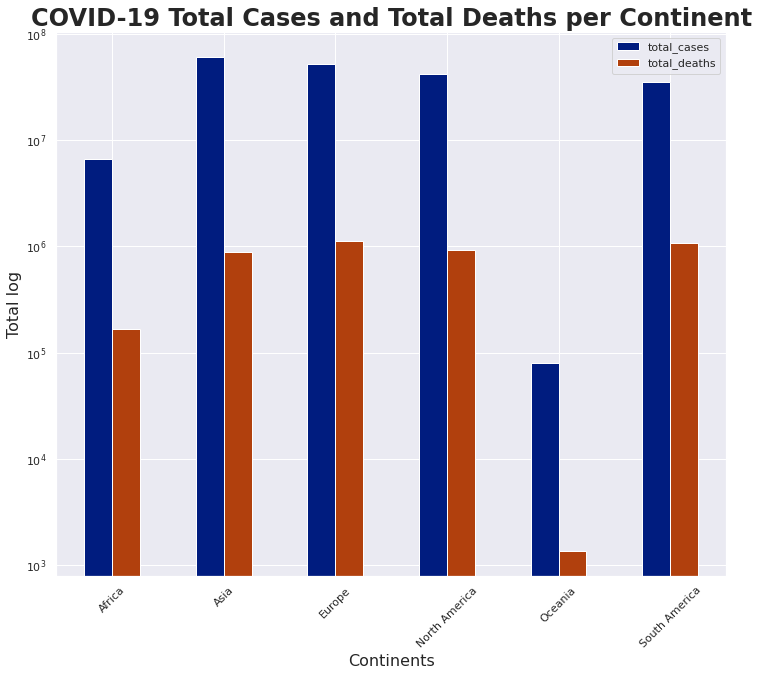

In [ ]:
ax_cont=total_continents_df[['total_cases','total_deaths']].plot(kind='bar',figsize=(12,10),logy=True)
ax_cont.set_title("COVID-19 Total Cases and Total Deaths per Continent",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_cont.set_xlabel('Continents',fontsize = 16, )
ax_cont.set_ylabel('Total log',fontsize = 16)
ax_cont.set_xticklabels(total_continents_df.index, rotation=45 );

Get the total vaccinations

In [ ]:
vaccinations_df =  df.groupby(['continent','country'])['new_vaccinations','people_vaccinated','people_fully_vaccinated','total_vaccinations','total_vaccinations_per_hundred'].max()
vaccinations_df.reset_index(inplace=True)
vaccinations_df

,continent,country,new_vaccinations,people_vaccinated,people_fully_vaccinated,total_vaccinations,total_vaccinations_per_hundred
0,Africa,Algeria,30.0,75000.0,0.0,75000.0,0.2
1,Africa,Angola,0.0,958373.0,634164.0,1592537.0,4.8
2,Africa,Benin,0.0,43377.0,14509.0,57886.0,0.5
3,Africa,Botswana,10435.0,209890.0,121518.0,331408.0,14.1
4,Africa,Burkina Faso,0.0,34749.0,2371.0,37120.0,0.2
...,...,...,...,...,...,...,...
217,South America,Paraguay,120776.0,1837008.0,286989.0,2123997.0,29.8
218,South America,Peru,334172.0,7819321.0,4702462.0,12521783.0,38.0
219,South America,Suriname,9775.0,185653.0,55782.0,241435.0,41.2
220,South America,Uruguay,63597.0,2553268.0,2189634.0,4742902.0,136.5


In [ ]:
cont_vax_df = vaccinations_df.groupby('continent').sum()
cont_vax_df

,new_vaccinations,people_vaccinated,people_fully_vaccinated,total_vaccinations,total_vaccinations_per_hundred
continent,,,,,
Africa,1969432.0,42983283.0,22007519.0,63784801.0,688.6
Asia,49639498.0,1289917045.0,489976306.0,2553647368.0,2352.0
Europe,9673234.0,360264280.0,287210936.0,635285670.0,4720.4
North America,7684860.0,280860713.0,221224799.0,489934631.0,2267.9
Oceania,264547.0,9954269.0,4545449.0,14499718.0,948.6
South America,6475294.0,183167384.0,81389849.0,257843449.0,843.8


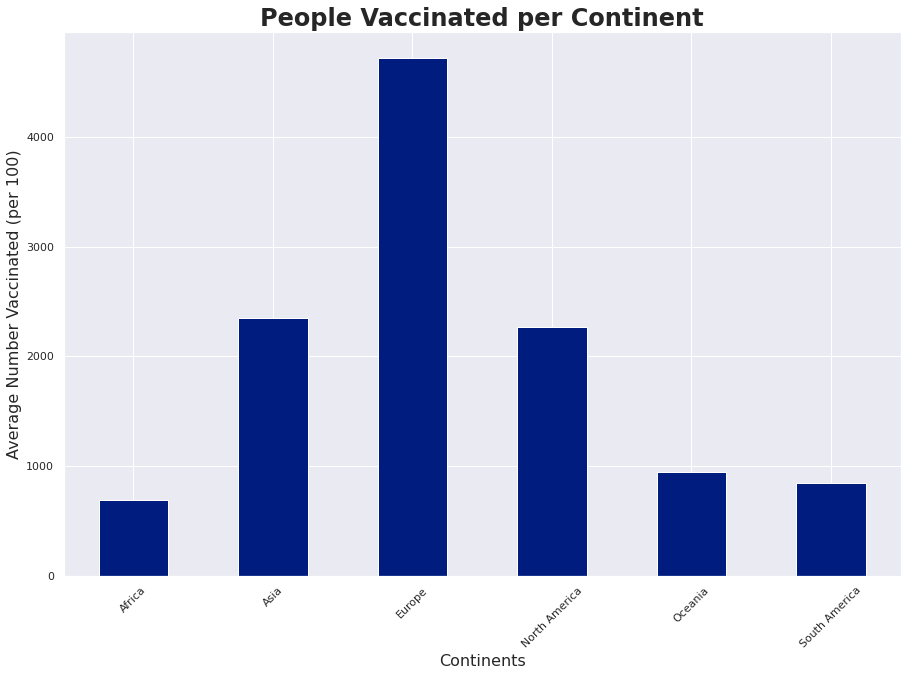

In [ ]:
ax_cont=cont_vax_df['total_vaccinations_per_hundred'].plot(kind='bar',figsize=(15,10),logy=False)
ax_cont.set_title("People Vaccinated per Continent",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_cont.set_xlabel('Continents',fontsize = 16, )
ax_cont.set_ylabel('Average Number Vaccinated (per 100)',fontsize = 16)
ax_cont.set_xticklabels(total_continents_df.index, rotation=45 );

GEOPANDAS


Use geopandas to Visualize the Covid Dataset


In [ ]:
# World Shapefile
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,53950935,Africa,Tanzania,TZA,150600.0,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253,Africa,W. Sahara,ESH,906.5,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,35623680,North America,Canada,CAN,1674000.0,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,326625791,North America,United States of America,USA,18560000.0,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


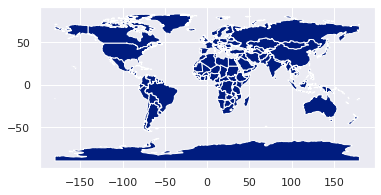

In [ ]:
#Basic plot, random colors
world.plot();

In [ ]:
type(world)

geopandas.geodataframe.GeoDataFrame

In [ ]:
# Dropped the Pop_est & gdp_md_est columns in the World Shapefile as we will not be using them
world = world.drop(columns=['pop_est','gdp_md_est'])
world.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 177 entries, 0 to 176
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   continent  177 non-null    object  
 1   name       177 non-null    object  
 2   iso_a3     177 non-null    object  
 3   geometry   177 non-null    geometry
dtypes: geometry(1), object(3)
memory usage: 5.7+ KB


In [ ]:
# Rename columns to match the covid dataset columns
world = world.rename(columns={'iso_a3':'iso_code'})

world.info()


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 177 entries, 0 to 176
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   continent  177 non-null    object  
 1   name       177 non-null    object  
 2   iso_code   177 non-null    object  
 3   geometry   177 non-null    geometry
dtypes: geometry(1), object(3)
memory usage: 5.7+ KB


Merge world shapefile to covid dataset

In [ ]:
# Merge shapefile with dataset -- Combined dataset is geo_df
geo_df  = df.merge(world, on='iso_code', how='left')
geo_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100812 entries, 0 to 100811
Data columns (total 33 columns):
 #   Column                               Non-Null Count   Dtype   
---  ------                               --------------   -----   
 0   iso_code                             100812 non-null  object  
 1   continent_x                          100812 non-null  object  
 2   country                              100812 non-null  object  
 3   date                                 100812 non-null  object  
 4   total_cases                          100812 non-null  float64 
 5   new_cases                            100812 non-null  float64 
 6   total_deaths                         100812 non-null  float64 
 7   new_deaths                           100812 non-null  float64 
 8   total_cases_per_million              100812 non-null  float64 
 9   new_cases_per_million                100812 non-null  float64 
 10  total_deaths_per_million             100812 non-null  float64 
 11  

In [ ]:
geo_df.head()

,iso_code,continent_x,country,date,total_cases,new_cases,total_deaths,new_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population,population_density,median_age,gdp_per_capita,extreme_poverty,hospital_beds_per_thousand,human_development_index,continent_y,name,geometry
0,AFG,Asia,Afghanistan,2020-02-24,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.3,38928341.0,54.4,18.6,1804.0,0.0,0.5,0.5,Asia,Afghanistan,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
1,AFG,Asia,Afghanistan,2020-02-25,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.3,38928341.0,54.4,18.6,1804.0,0.0,0.5,0.5,Asia,Afghanistan,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
2,AFG,Asia,Afghanistan,2020-02-26,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.3,38928341.0,54.4,18.6,1804.0,0.0,0.5,0.5,Asia,Afghanistan,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
3,AFG,Asia,Afghanistan,2020-02-27,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.3,38928341.0,54.4,18.6,1804.0,0.0,0.5,0.5,Asia,Afghanistan,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
4,AFG,Asia,Afghanistan,2020-02-28,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.3,38928341.0,54.4,18.6,1804.0,0.0,0.5,0.5,Asia,Afghanistan,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."


In [ ]:
type(geo_df)

pandas.core.frame.DataFrame

In [ ]:
# Convert pandas dataframe to geodataframe
geo_df = gpd.GeoDataFrame(geo_df, geometry='geometry')


In [ ]:
type(geo_df)

geopandas.geodataframe.GeoDataFrame

In [ ]:
# Convert Date to unix time in nanoseconds:

geo_df['date_sec'] = pd.to_datetime(geo_df['date']).astype(int) // 10**9
geo_df['date_sec'] = geo_df['date_sec'].astype(int).astype(str)

#geo_df

In [ ]:
# Select columns needed for the map

timeseries_df = geo_df[['country', 'date_sec', 'total_cases', 'geometry']]


timeseries_df.head()

,country,date_sec,total_cases,geometry
0,Afghanistan,1582502400,1.0,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
1,Afghanistan,1582588800,1.0,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
2,Afghanistan,1582675200,1.0,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
3,Afghanistan,1582761600,1.0,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
4,Afghanistan,1582848000,1.0,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."


In [ ]:
type(timeseries_df)

geopandas.geodataframe.GeoDataFrame

In [ ]:
# Initialize the map Tile

mymap = folium.Map(tiles='cartodbpositron')
mymap.save(outfile='infinite_scroll.html')

mymap_fix_boundary = folium.Map(min_zoom=10, max_bounds=True, tiles='cartodbpositron')
mymap_fix_boundary.save(outfile='fix_boundary.html')

max_colour = max(timeseries_df['total_cases'])
min_colour = min(timeseries_df['total_cases'])
cmap = cm.linear.YlOrRd_09.scale(min_colour, max_colour)
timeseries_df['colour'] = timeseries_df['total_cases'].map(cmap)

In [ ]:
country_list = timeseries_df['country'].unique().tolist()
country_idx = range(len(country_list))

style_dict = {}
for i in country_idx:
    country = country_list[i]
    result = timeseries_df[timeseries_df['country'] == country]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date_sec']] = {'color': r['colour'], 'opacity': 0.7}
    style_dict[str(i)] = inner_dict

In [ ]:
countries_df = timeseries_df[['geometry']]
countries_gdf = gpd.GeoDataFrame(countries_df)
countries_gdf = countries_gdf.drop_duplicates().reset_index()

countries_gdf

,index,geometry
0,0,"POLYGON ((66.51861 37.36278, 67.07578 37.35614..."
1,521,"POLYGON ((21.02004 40.84273, 20.99999 40.58000..."
2,1041,"POLYGON ((-8.68440 27.39574, -8.66512 27.58948..."
3,1561,None
4,2075,"MULTIPOLYGON (((12.99552 -4.78110, 12.63161 -4..."
...,...,...
163,98168,"POLYGON ((-60.73357 5.20028, -60.60118 4.91810..."
164,98670,"POLYGON ((104.33433 10.48654, 105.19991 10.889..."
165,99343,"POLYGON ((52.00001 19.00000, 52.78218 17.34974..."
166,99818,"POLYGON ((30.74001 -8.34001, 31.15775 -8.59458..."


In [ ]:
from folium.plugins import TimeSliderChoropleth

slider_map = folium.Map(min_zoom=2, max_bounds=True,tiles='cartodbpositron')

_ = TimeSliderChoropleth(
    data=countries_gdf.to_json(),
    styledict=style_dict,

).add_to(slider_map)

_ = cmap.add_to(slider_map)
cmap.caption = "Log of number of Covid Total cases"
slider_map.save(outfile='TotalCasesTimeSliderChoropleth.html')

slider_map

In [ ]:
geo_df['continent_x'].unique()

array(['Asia', 'Europe', 'Africa', 'North America', 'South America',
       'Oceania'], dtype=object)

Visualize the data

In [ ]:
# Filter data for date == 2021-06-01
flt =(geo_df['date'] == '2021-06-22')
june_df= geo_df[flt].sort_values(by='total_cases',  ascending=False, inplace=False)
june_df



,iso_code,continent_x,country,date,total_cases,new_cases,total_deaths,new_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population,population_density,median_age,gdp_per_capita,extreme_poverty,hospital_beds_per_thousand,human_development_index,continent_y,name,geometry,date_sec
96356,USA,North America,United States,2021-06-22,33565215.0,10940.0,602359.0,326.0,101404.7,33.1,1819.8,1.0,12520.0,37.8,0.0,319223844.0,177635067.0,150424675.0,647403.0,95.5,53.1,45.0,61.6,331002647.0,35.6,38.3,54225.4,1.2,2.8,0.9,North America,United States of America,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",1624320000
42014,IND,Asia,India,2021-06-22,30028709.0,50848.0,390660.0,1358.0,21759.9,36.8,283.1,1.0,0.0,0.0,0.0,289855456.0,238586187.0,51269269.0,6541514.0,21.0,17.3,3.7,81.9,1380004385.0,450.4,28.2,6426.7,21.2,0.5,0.6,Asia,India,"POLYGON ((97.32711 28.26158, 97.40256 27.88254...",1624320000
12815,BRA,South America,Brazil,2021-06-22,18054653.0,87822.0,504717.0,2131.0,84939.3,413.2,2374.5,10.0,0.0,0.0,0.0,90077011.0,0.0,0.0,1723948.0,42.4,0.0,0.0,60.6,212559409.0,25.0,33.5,14103.5,3.4,2.2,0.8,South America,Brazil,"POLYGON ((-53.37366 -33.76838, -53.65054 -33.2...",1624320000
32520,FRA,Europe,France,2021-06-22,5821797.0,2213.0,110991.0,51.0,86166.8,32.8,1642.7,0.8,10046.0,148.7,0.0,49910166.0,32721296.0,17702621.0,685160.0,73.9,48.4,26.2,44.4,67564251.0,122.6,42.0,38605.7,0.0,6.0,0.9,NaN,NaN,None,1624320000
93456,TUR,Asia,Turkey,2021-06-22,5381736.0,6143.0,49293.0,57.0,63810.7,72.8,584.5,0.7,0.0,0.0,0.0,44080123.0,29462165.0,14617958.0,450944.0,52.3,34.9,17.3,64.8,84339067.0,104.9,31.6,25129.3,0.2,2.8,0.8,Asia,Turkey,"MULTIPOLYGON (((44.77268 37.17044, 44.29345 37...",1624320000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22962,CUW,North America,Curacao,2021-06-22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,164881.0,88174.0,76707.0,300.0,100.5,53.7,46.7,0.0,164100.0,362.6,41.7,0.0,0.0,0.0,0.0,NaN,NaN,None,1624320000
72534,PCN,Oceania,Pitcairn,2021-06-22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,None,1624320000
17205,CYM,North America,Cayman Islands,2021-06-22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,89619.0,47419.0,41949.0,708.0,136.4,72.2,63.8,0.0,65720.0,256.5,0.0,49903.0,0.0,0.0,0.0,NaN,NaN,None,1624320000
81671,SXM,North America,Sint Maarten (Dutch part),2021-06-22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,42882.0,1209.1,0.0,36327.2,0.0,0.0,0.0,NaN,NaN,None,1624320000


In [ ]:
type(june_df)

geopandas.geodataframe.GeoDataFrame

In [ ]:
# Create dataframe for the Total Cases

june_total_cases_df = june_df[['iso_code','country','total_cases','total_cases_per_million','geometry']]


In [ ]:
# Convert pandas dataframe to geodataframe
june_total_cases_df = gpd.GeoDataFrame(june_total_cases_df, geometry='geometry')


Total COVID-19 Cases

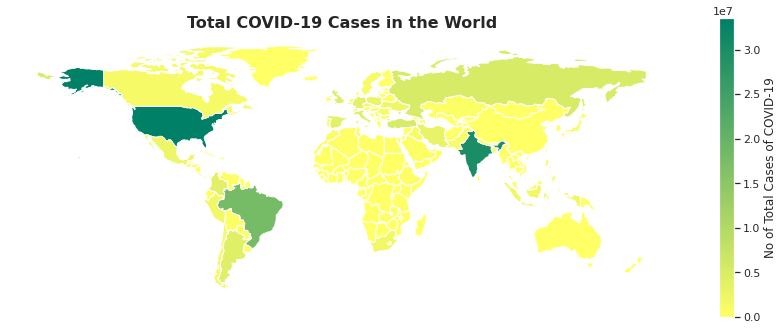

In [ ]:
# Generate the choropleth map using gdf plot function on the Total Cases

columnfig = june_total_cases_df.plot(column='total_cases',cmap='summer_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "No of Total Cases of COVID-19",'orientation': "vertical", 'shrink': 0.55})

# Removing axis ticks
plt.axis('off')

# Add the title
plt.title("Total COVID-19 Cases in the World",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

In [ ]:
# Individual continents

asia = june_df[june_df['continent_x'] == 'Asia']
africa = june_df[june_df['continent_x'] == 'Africa']
north_america = june_df[june_df['continent_x'] == 'North America']
europe = june_df[june_df['continent_x'] == 'Europe']
south_america = june_df[june_df['continent_x'] == 'South America']

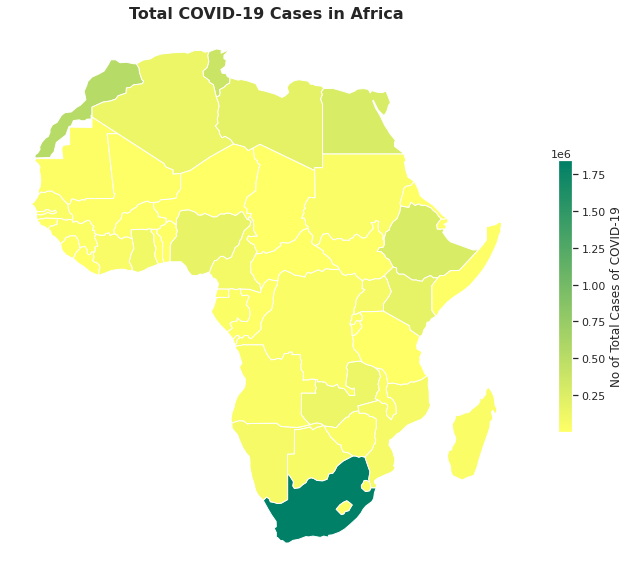

In [ ]:
map_africa = africa.plot(column='total_cases',cmap='summer_r',figsize=(12,10), legend = True,
                                legend_kwds={'label': "No of Total Cases of COVID-19",'orientation': "vertical", 'shrink': 0.5})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total COVID-19 Cases in Africa",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

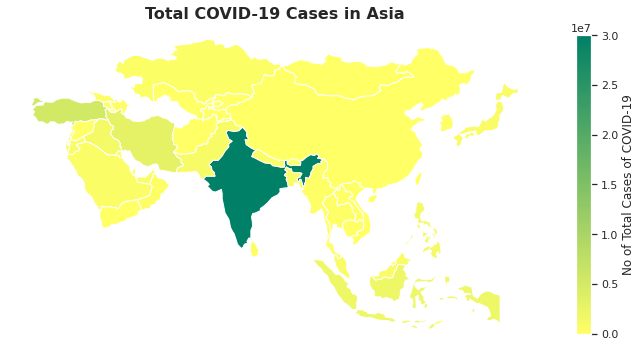

In [ ]:
map_asia = asia.plot(column='total_cases',cmap='summer_r',figsize=(12,10), legend = True,
                                legend_kwds={'label': "No of Total Cases of COVID-19",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total COVID-19 Cases in Asia",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

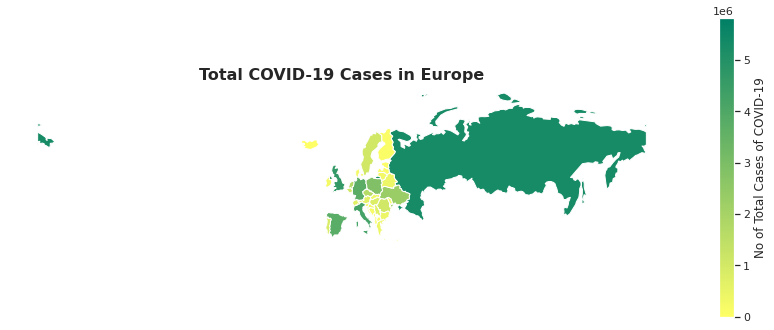

In [ ]:
map_europe = europe.plot(column='total_cases',cmap='summer_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "No of Total Cases of COVID-19",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total COVID-19 Cases in Europe",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

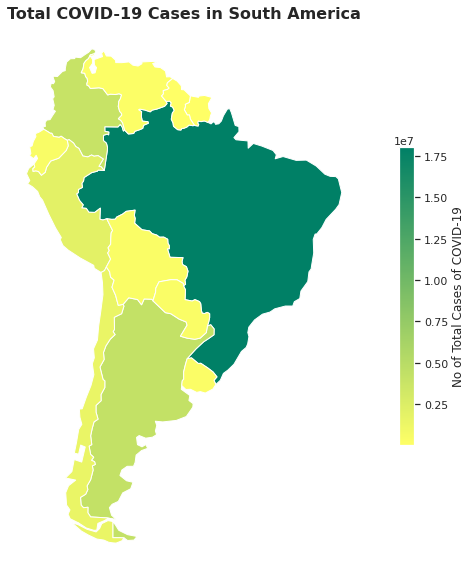

In [ ]:
map_south_america = south_america.plot(column='total_cases',cmap='summer_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "No of Total Cases of COVID-19",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total COVID-19 Cases in South America",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

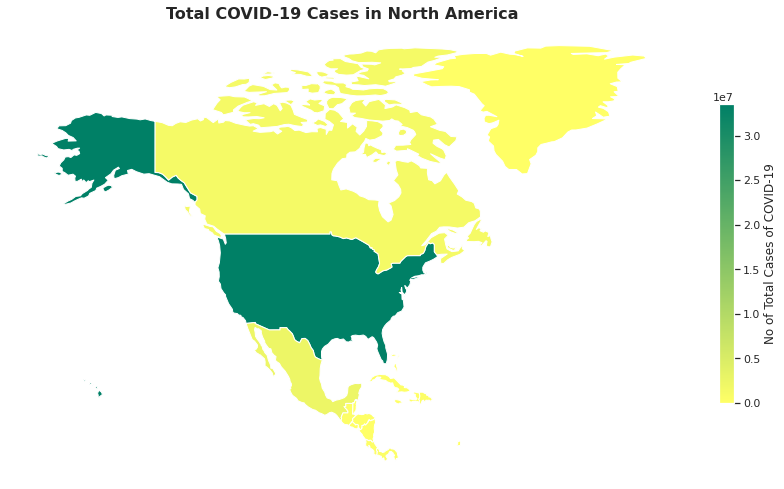

In [ ]:
map_north_america = north_america.plot(column='total_cases',cmap='summer_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "No of Total Cases of COVID-19",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total COVID-19 Cases in North America",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

 Total Deaths

In [ ]:
#Create a dataframe

june_deaths_df = june_df[['iso_code','country','total_deaths','total_deaths_per_million','geometry']]


In [ ]:
june_deaths_df = gpd.GeoDataFrame(june_deaths_df, geometry='geometry')

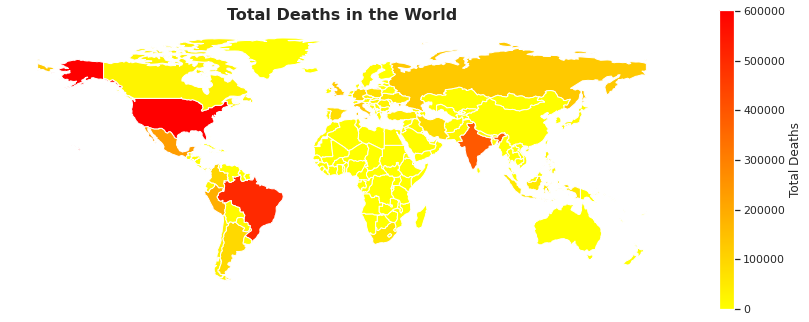

In [ ]:
#Generate the choropleth map using gdf plot function on the Total Deaths 

columnfig = june_deaths_df.plot(column='total_deaths',cmap='autumn_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Deaths", 'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Deaths in the World",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

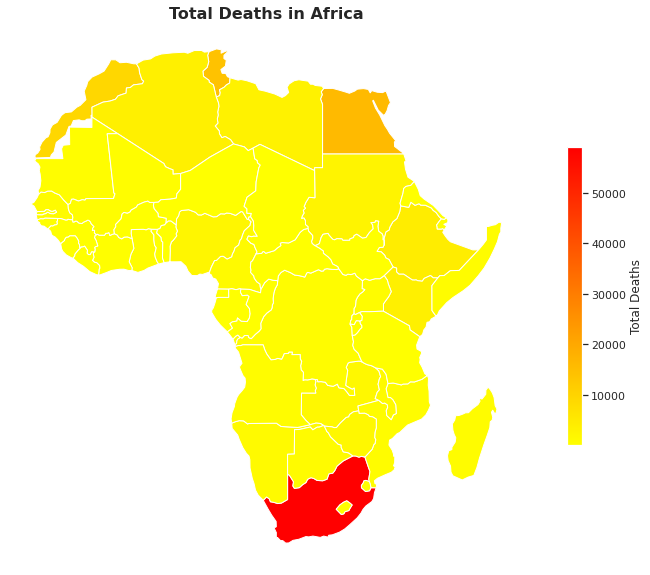

In [ ]:
# Continents Total Deaths

map_africa = africa.plot(column='total_deaths',cmap='autumn_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Deaths",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Deaths in Africa",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

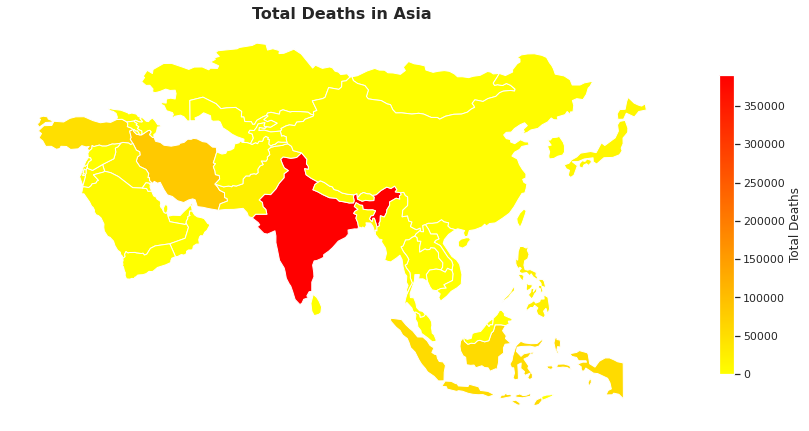

In [ ]:
map_asia = asia.plot(column='total_deaths',cmap='autumn_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Deaths",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Deaths in Asia",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

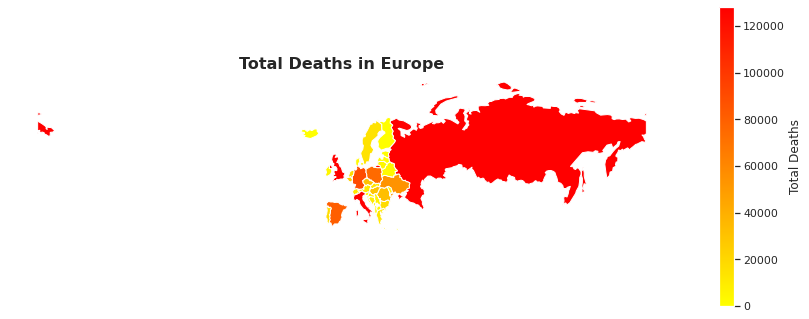

In [ ]:
map_europe = europe.plot(column='total_deaths',cmap='autumn_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Deaths",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Deaths in Europe",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

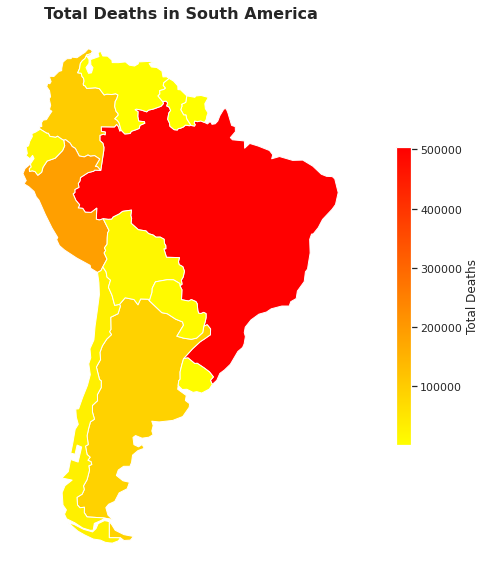

In [ ]:
map_south_america = south_america.plot(column='total_deaths',cmap='autumn_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Deaths",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Deaths in South America",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

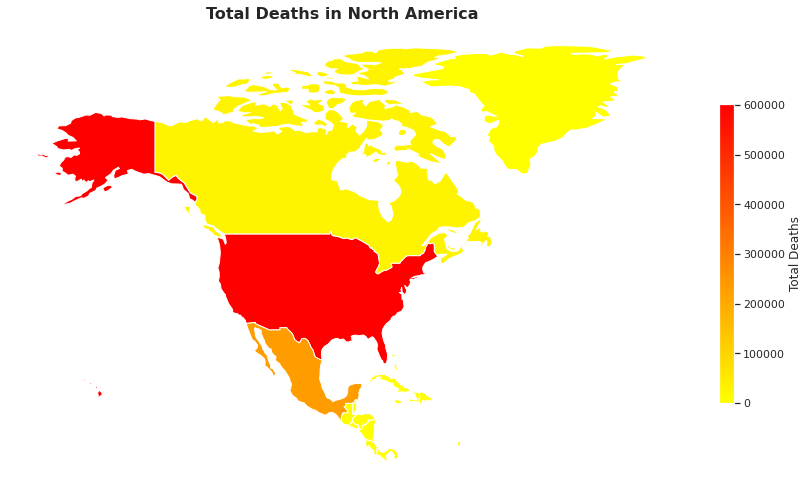

In [ ]:
map_north_america = north_america.plot(column='total_deaths',cmap='autumn_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Deaths",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Deaths in North America",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

Vaccinations


In [ ]:
#Create a Vaccination dataframe

june_people_vaccinated = june_df[['iso_code','country','total_vaccinations','total_vaccinations_per_hundred','people_vaccinated','people_vaccinated_per_hundred','people_fully_vaccinated','people_fully_vaccinated_per_hundred','geometry']]

june_people_vaccinated = june_people_vaccinated.sort_values(by='total_vaccinations_per_hundred',ascending=False)
june_people_vaccinated.head(10)

,iso_code,country,total_vaccinations,total_vaccinations_per_hundred,people_vaccinated,people_vaccinated_per_hundred,people_fully_vaccinated,people_fully_vaccinated_per_hundred,geometry
57446,MLT,Malta,636059.0,144.1,353584.0,80.1,294650.0,66.7,None
17205,CYM,Cayman Islands,89619.0,136.4,47419.0,72.2,41949.0,63.8,None
78019,SMR,San Marino,44386.0,130.8,22295.0,65.7,22295.0,65.7,None
44805,ISR,Israel,10661294.0,123.2,5507523.0,63.6,5153771.0,59.5,"POLYGON ((35.71992 32.70919, 35.54567 32.39399..."
4419,ABW,Aruba,124332.0,116.5,67004.0,62.8,57328.0,53.7,None
37385,GGY,Guernsey,77881.0,116.2,0.0,0.0,0.0,0.0,None
7025,BHR,Bahrain,1968183.0,115.7,1046710.0,61.5,921473.0,54.1,None
44280,IMN,Isle of Man,97379.0,114.5,62418.0,73.4,34961.0,41.1,None
18724,CHL,Chile,21832700.0,114.2,12258935.0,64.1,9796402.0,51.2,"MULTIPOLYGON (((-68.63401 -52.63637, -68.63335..."
61014,MNG,Mongolia,3633222.0,110.8,1924675.0,58.7,1708547.0,52.1,"POLYGON ((87.75126 49.29720, 88.80557 49.47052..."


In [ ]:
flt_country = june_df.country == "Mongolia"
june_df[flt_country]

,iso_code,continent_x,country,date,total_cases,new_cases,total_deaths,new_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population,population_density,median_age,gdp_per_capita,extreme_poverty,hospital_beds_per_thousand,human_development_index,continent_y,name,geometry,date_sec
61014,MNG,Asia,Mongolia,2021-06-22,98050.0,0.0,459.0,0.0,29908.9,0.0,140.0,0.0,0.0,0.0,0.0,3633222.0,1924675.0,1708547.0,0.0,110.8,58.7,52.1,59.3,3278292.0,2.0,28.6,11840.8,0.5,7.0,0.7,Asia,Mongolia,"POLYGON ((87.75126 49.29720, 88.80557 49.47052...",1624320000


In [ ]:
june_people_vaccinated = gpd.GeoDataFrame(june_people_vaccinated, geometry='geometry')

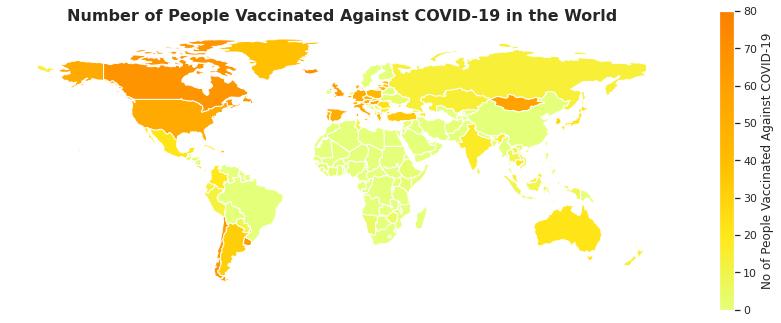

In [ ]:
#Generate the choropleth map using gdf plot function on people Vaccinated per hundred

columnfig = june_people_vaccinated.plot(column='people_vaccinated_per_hundred',cmap='Wistia',figsize=(15,10), legend = True,
                                legend_kwds={'label': "No of People Vaccinated Against COVID-19",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Number of People Vaccinated Against COVID-19 in the World",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

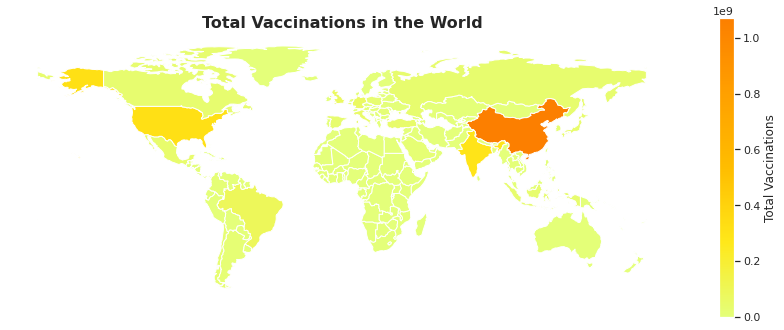

In [ ]:
#Generate the choropleth map using gdf plot function on the Total Vaccinations

columnfig = june_people_vaccinated.plot(column='total_vaccinations',cmap='Wistia',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Vaccinations",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Vaccinations in the World",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

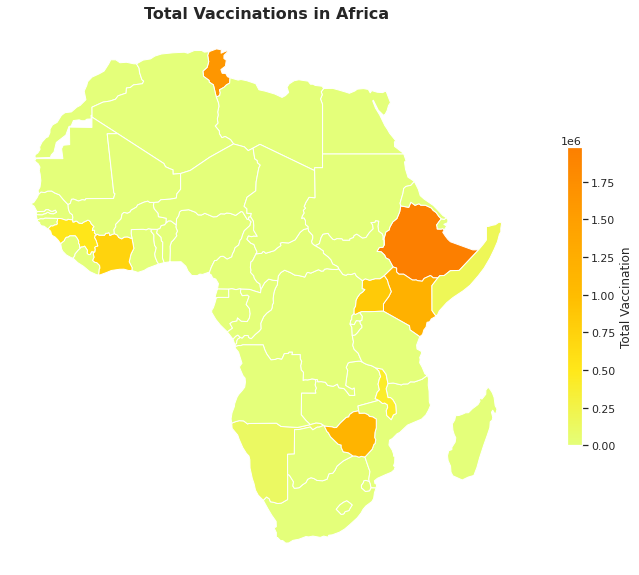

In [ ]:
map_africa = africa.plot(column='total_vaccinations',cmap='Wistia',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Vaccination",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Vaccinations in Africa",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

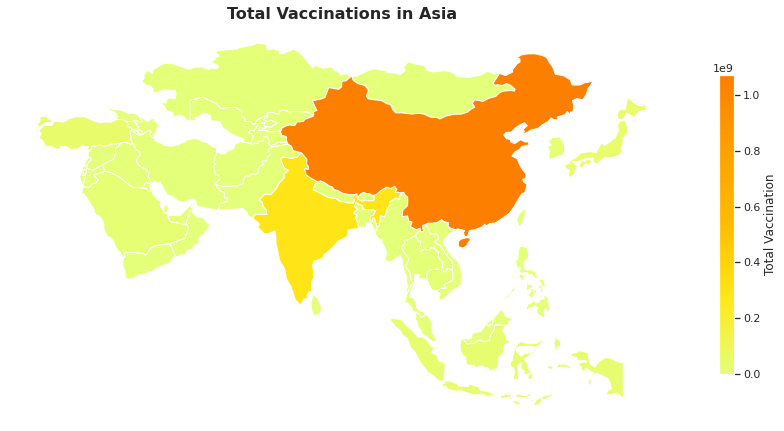

In [ ]:
map_asia = asia.plot(column='total_vaccinations',cmap='Wistia',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Vaccination",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Vaccinations in Asia",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

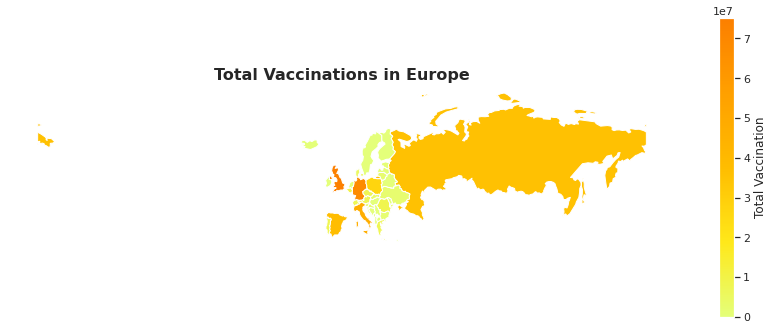

In [ ]:
map_europe = europe.plot(column='total_vaccinations',cmap='Wistia',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Vaccination",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Vaccinations in Europe",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

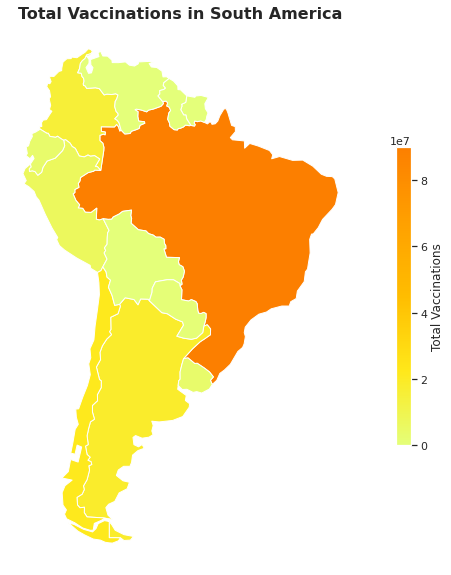

In [ ]:
map_south_america = south_america.plot(column='total_vaccinations',cmap='Wistia',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Vaccinations",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Vaccinations in South America",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

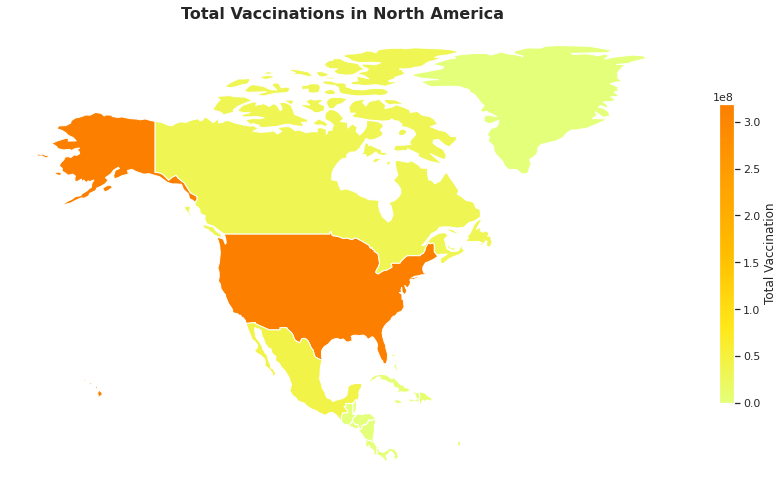

In [ ]:
map_north_america = north_america.plot(column='total_vaccinations',cmap='Wistia',figsize=(15,10), legend = True,
                                legend_kwds={'label': "Total Vaccination",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Total Vaccinations in North America",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

Comparison for people fully vaccinated

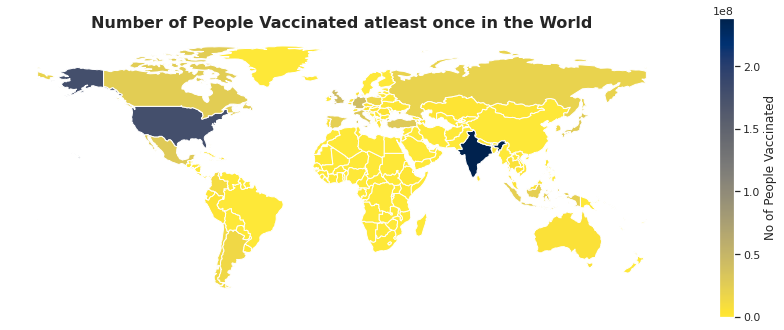

In [ ]:
columnfig = june_people_vaccinated.plot(column='people_vaccinated',cmap='cividis_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "No of People Vaccinated",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Number of People Vaccinated atleast once in the World",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

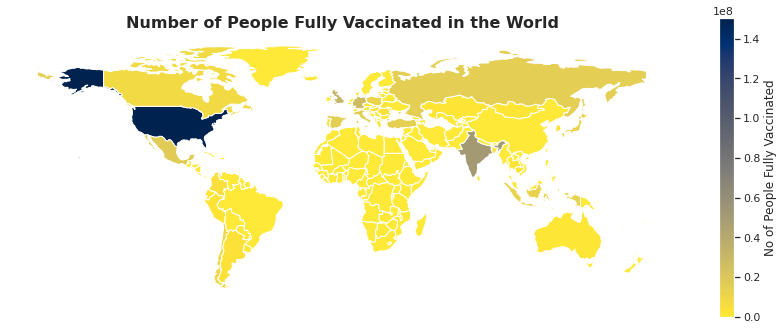

In [ ]:
columnfig = june_people_vaccinated.plot(column='people_fully_vaccinated',cmap='cividis_r',figsize=(15,10), legend = True,
                                legend_kwds={'label': "No of People Fully Vaccinated",'orientation': "vertical", 'shrink': 0.55})

#removing axis ticks
plt.axis('off')

#Add the title
plt.title("Number of People Fully Vaccinated in the World",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
plt.show()

Exprolatory Data 

Group by Dates

In [ ]:
#convert column datatype to date
df['date'] = pd.to_datetime(df['date'], format='%Y-%m-%d')


In [ ]:
# Group values in the dataframe by date
grouped_dates = df.groupby('date')
grouped_dates

In [ ]:
# Create a dataframe with the maximun values for each date
grouped_dates_max = grouped_dates.max()
# Create a dataframe with the sum of values for each date
grouped_dates_sum = grouped_dates.sum()

Text(0, 0.5, 'Population')

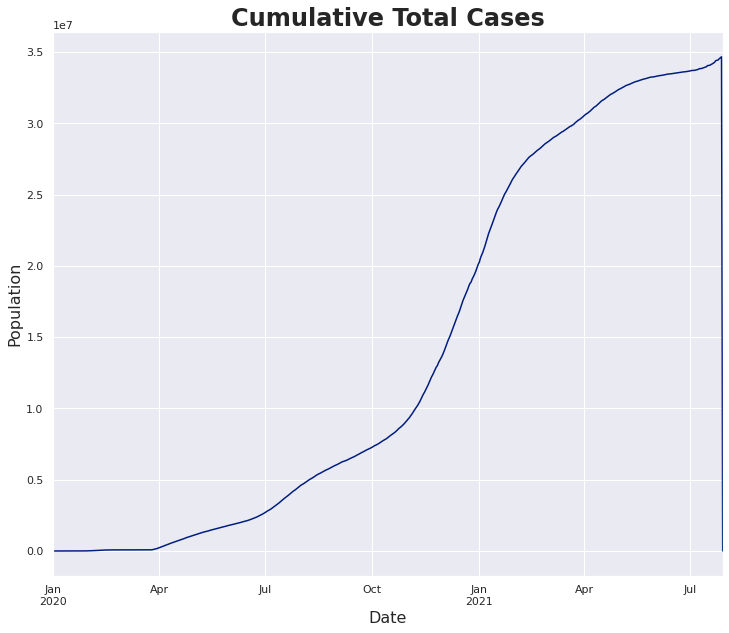

In [ ]:
# Plot the total cases column
ax_dt=grouped_dates_max['total_cases'].plot(kind='line',figsize=(12,10))

ax_dt.set_title("Cumulative Total Cases",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Population',fontsize = 16)


Text(0, 0.5, 'Number')

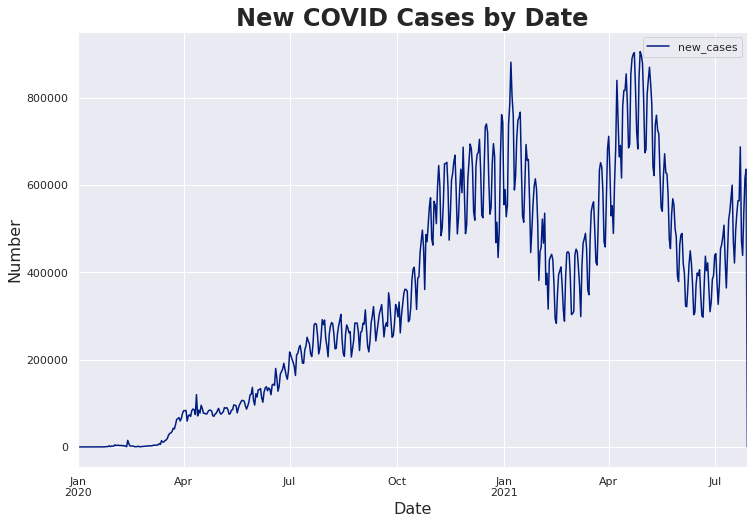

In [ ]:
ax_dt=grouped_dates_sum[['new_cases']].plot(kind='line',figsize=(12,8))
ax_dt.set_title("New COVID Cases by Date",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)


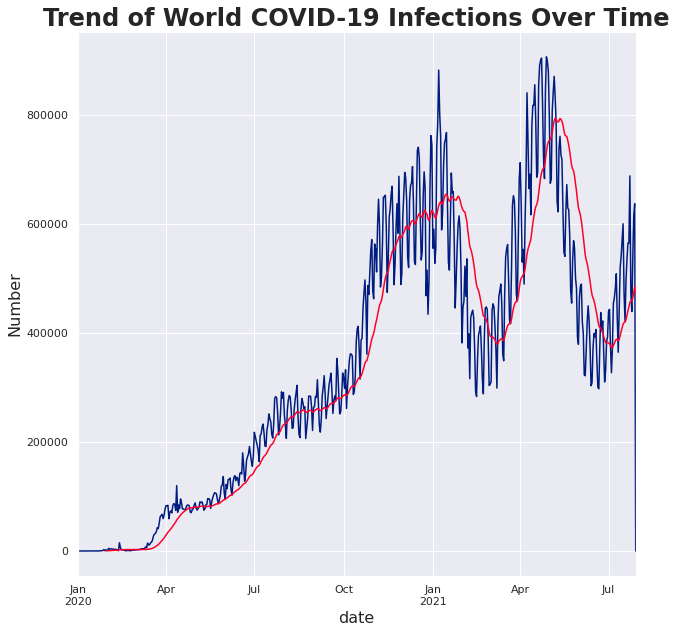

In [ ]:

ax_dt=grouped_dates_sum['new_cases'].plot(kind='line',figsize=(10,10),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)

ax_dt.set_title("Trend of World COVID-19 Infections Over Time",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_sum.index, rotation=45 );
grouped_dates_sum['new_cases'].rolling(window=30).mean().plot(cmap='gist_rainbow')

Text(0, 0.5, 'Number')

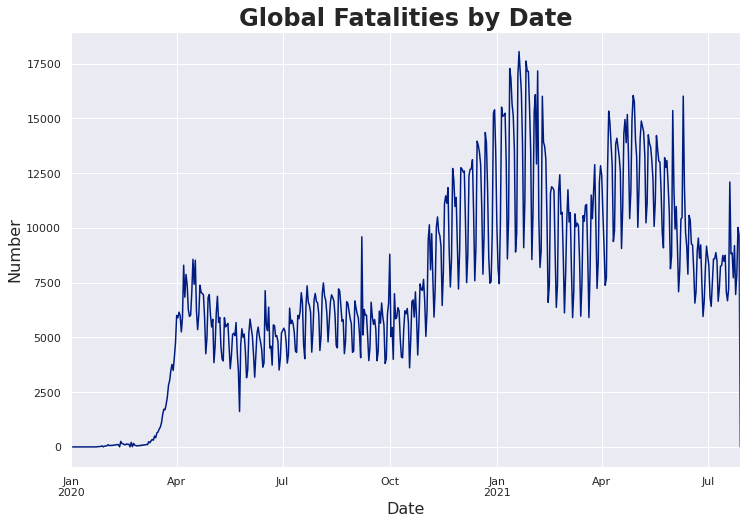

In [ ]:
ax_dt=grouped_dates_sum['new_deaths'].plot(kind='line',figsize=(12,8),logy=False)

ax_dt.set_title("Global Fatalities by Date",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)

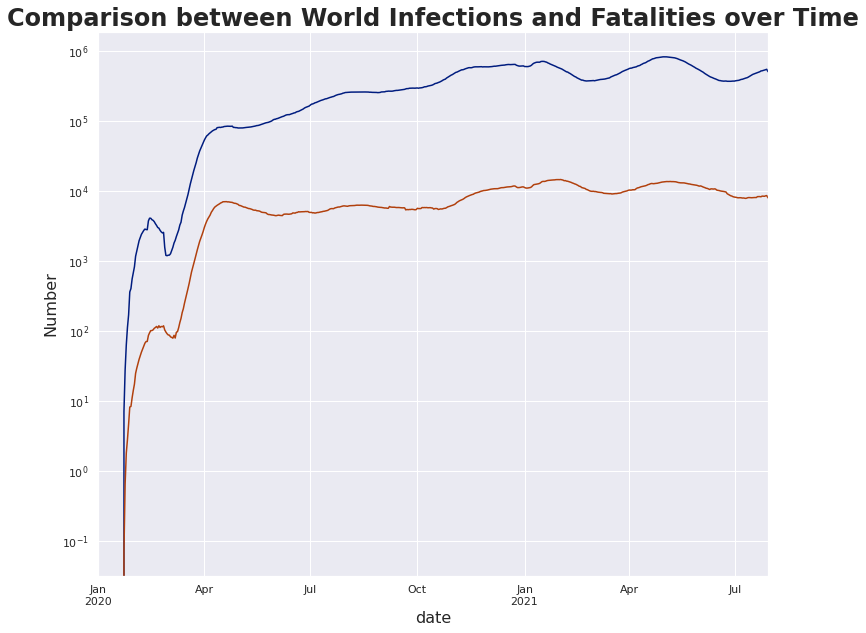

In [ ]:
ax_d=grouped_dates_sum['new_cases'].rolling(window=14).mean().plot(figsize=(12,10),logy=True)
ax_d.set_title("Comparison between World Infections and Fatalities over Time",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_d.set_xlabel('Date',fontsize = 16, )
ax_d.set_ylabel('Number',fontsize = 16)
ax_d.set_xticklabels(grouped_dates_sum.index, rotation=45 );
grouped_dates_sum['new_deaths'].rolling(window=14).mean().plot(logy=True)

Text(0, 0.5, 'Daily Fatalities')

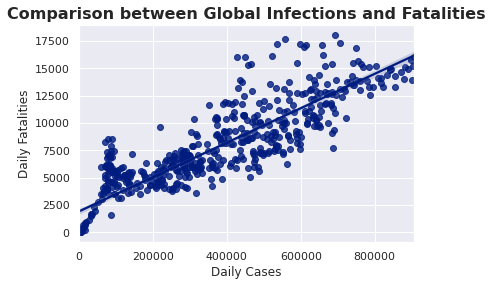

In [ ]:
ax_c=sns.regplot(x='new_cases', y='new_deaths', data= grouped_dates_sum)
ax_c.set_title("Comparison between Global Infections and Fatalities",fontdict= { 'fontsize': 16, 'fontweight':'bold'})
ax_c.set_xlabel('Daily Cases',fontsize = 12 )
ax_c.set_ylabel('Daily Fatalities',fontsize = 12)

In [ ]:
x=grouped_dates_sum['new_cases']
y=grouped_dates_sum['new_deaths']
x.corr(y)

0.8827638413141143

Group by country

In [ ]:
country_group = df.groupby('country')
usa_df = country_group.get_group("United States")
usa_df.set_index('date', inplace=True)
ke_df = country_group.get_group("Kenya")
ke_df.set_index('date', inplace=True)
sweden_df = country_group.get_group("Sweden")
sweden_df.set_index('date', inplace=True)
nz_df = country_group.get_group("New Zealand")
nz_df.set_index('date', inplace=True)
uk_df = country_group.get_group("United Kingdom")
uk_df.set_index('date', inplace=True)
ind_df = country_group.get_group("India")
ind_df.set_index('date', inplace=True)
sa_df = country_group.get_group("South Africa")
sa_df.set_index('date', inplace=True)

In [ ]:
country_df= country_group.sum().sort_values(by='new_cases',ascending=False)
country_df = country_df.rename(columns={'new_cases':'cases'})
country_df = country_df.rename(columns={'new_deaths':'deaths'})
country_df = country_df.rename(columns={'new_vaccinations':'vaccinations'})
country_df.head(2)

,total_cases,cases,total_deaths,deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,total_vaccinations,people_vaccinated,people_fully_vaccinated,vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population,population_density,median_age,gdp_per_capita,extreme_poverty,hospital_beds_per_thousand,human_development_index
country,,,,,,,,,,,,,,,,,,,,,,,,,,
United States,8072596731.0,34672689.0,159748064.0,611801.0,24388314.7,104750.5,482618.7,1848.3,18816552.0,56847.1,2459087.0,37797339930.0,22312117872.0,16343650929.0,328707182.0,11301.6,6671.5,4886.8,32988.7,183375466438.0,19726.8,21218.2,30040897.1,664.8,1534.6,513.0
India,5038143958.0,31528114.0,67843283.0,422662.0,3650817.3,22846.4,49161.6,306.3,0.0,0.0,0.0,28044968738.0,22764807358.0,5280161380.0,424382721.0,2032.2,1649.6,382.6,38622.7,753482394210.0,245928.8,15397.2,3508964.0,11575.2,289.4,352.2


Text(0, 0.5, 'Number')

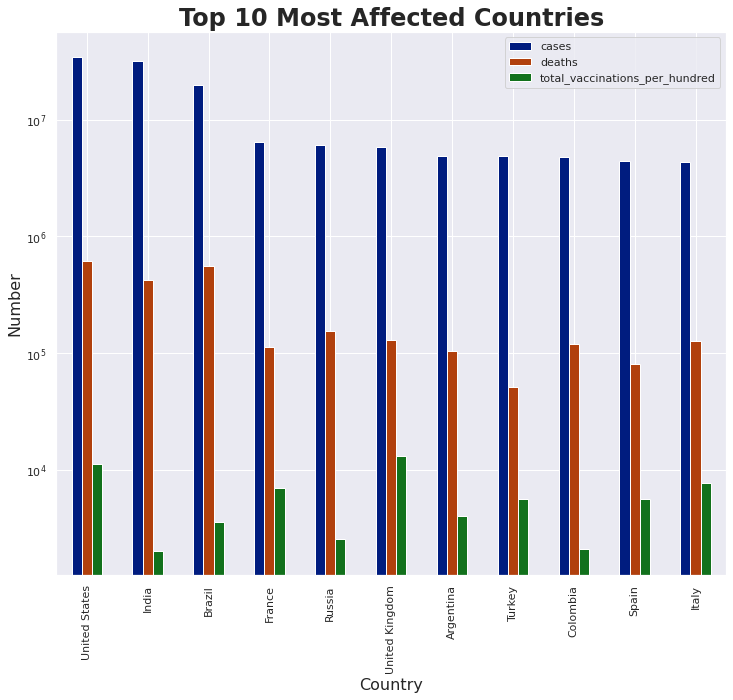

In [ ]:
ax_ct=country_df.iloc[:11][['cases','deaths','total_vaccinations_per_hundred']].plot(kind='bar',figsize=(12,10),logy=True)

ax_ct.set_title("Top 10 Most Affected Countries",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_ct.set_xlabel('Country',fontsize = 16, )
ax_ct.set_ylabel('Number',fontsize = 16)

Text(0, 0.5, 'Number')

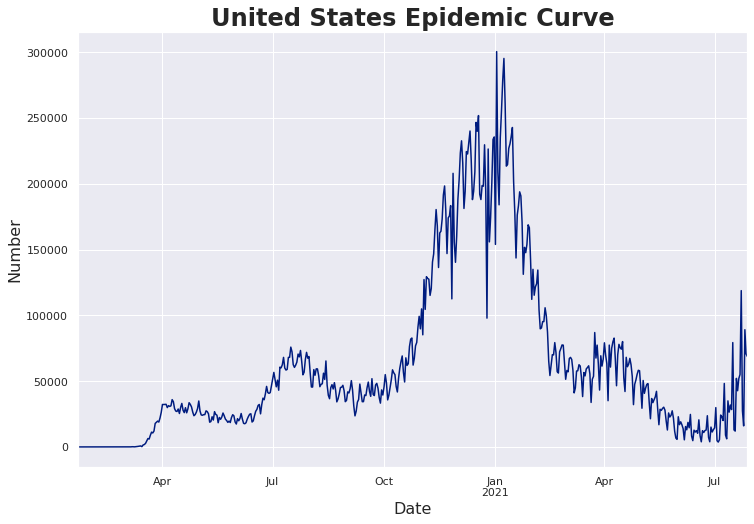

In [ ]:
ax_dt=usa_df['new_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("United States Epidemic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );
#usa_df['new_cases'].rolling(window=14).mean().plot()

Text(0, 0.5, 'Population')

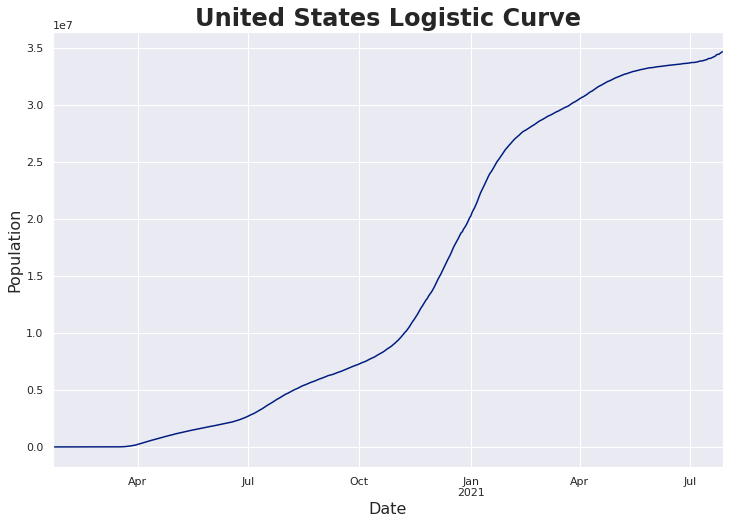

In [ ]:
ax_dt=usa_df['total_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("United States Logistic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Population',fontsize = 16, )

Text(0, 0.5, 'Number')

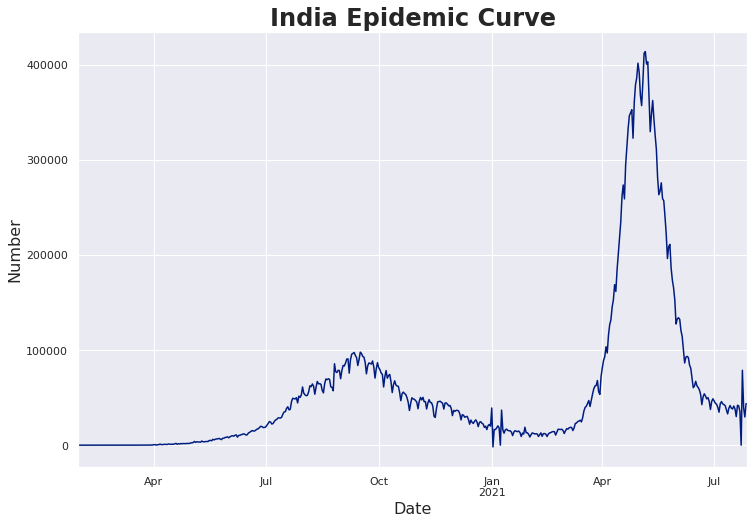

In [ ]:
ax_dt=ind_df['new_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("India Epidemic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );
#ind_df['new_cases'].rolling(window=14).mean().plot()

Text(0, 0.5, 'Population')

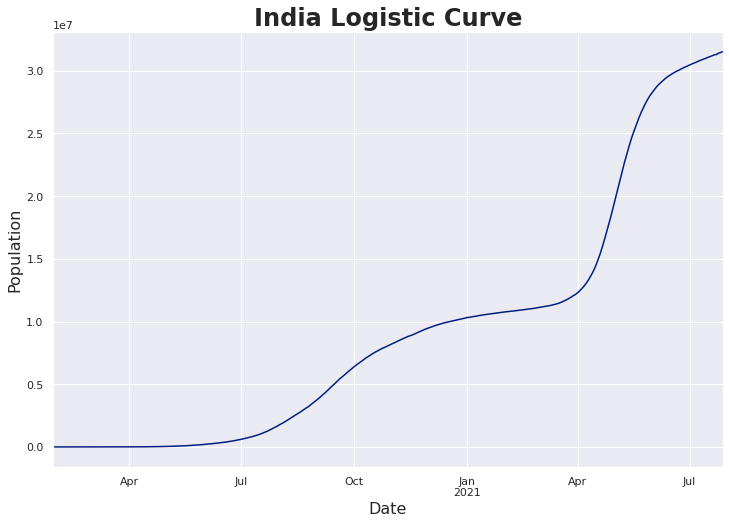

In [ ]:
ax_dt=ind_df['total_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("India Logistic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Population',fontsize = 16, )

Text(0, 0.5, 'Number')

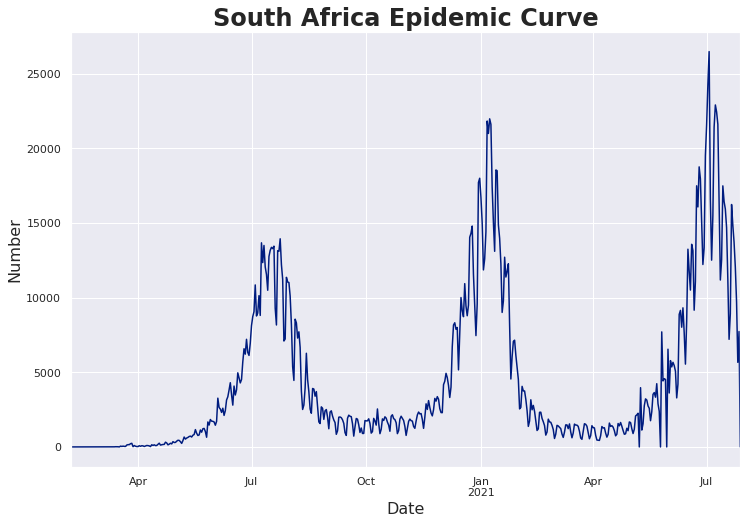

In [ ]:
ax_dt=sa_df['new_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("South Africa Epidemic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );
#ke_df['new_cases'].rolling(window=14).mean().plot()

Text(0, 0.5, 'Population')

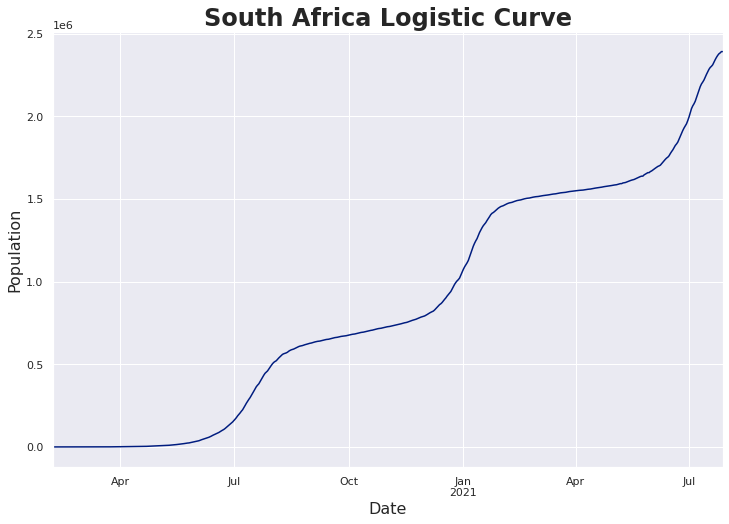

In [ ]:
ax_dt=sa_df['total_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("South Africa Logistic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Population',fontsize = 16, )

Text(0, 0.5, 'Number')

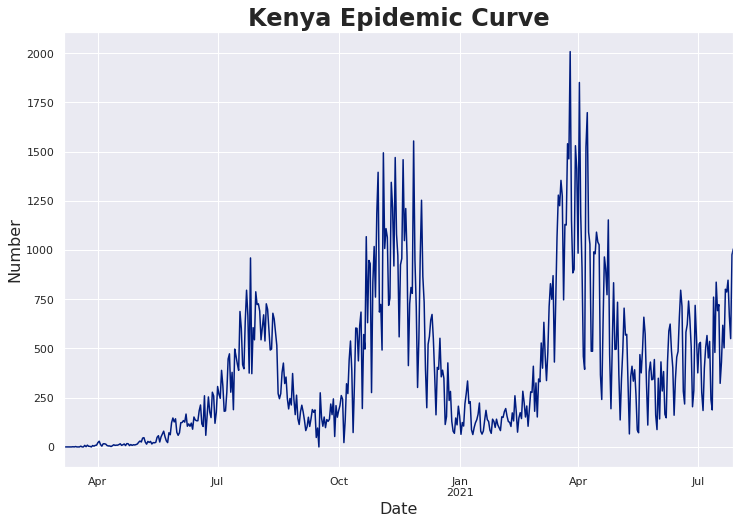

In [ ]:
ax_dt=ke_df['new_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("Kenya Epidemic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );
#ke_df['new_cases'].rolling(window=14).mean().plot()

Text(0, 0.5, 'Population')

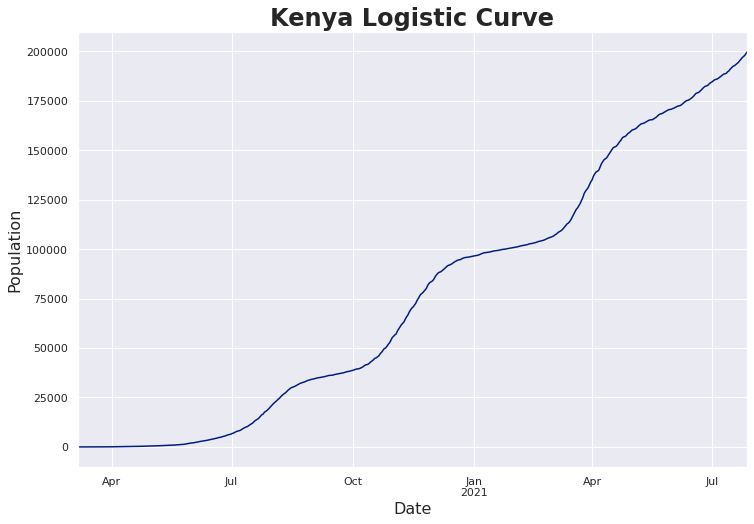

In [ ]:
ax_dt=ke_df['total_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("Kenya Logistic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Population',fontsize = 16, )

Compare a country that locked down vs one that did not.

Text(0, 0.5, 'Number')

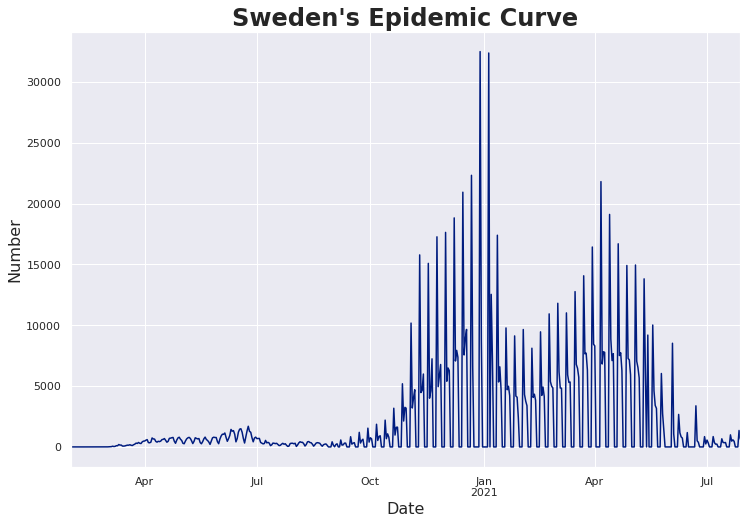

In [ ]:
ax_dt=sweden_df['new_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("Sweden's Epidemic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );
#sweden_df['new_cases'].rolling(window=14).mean().plot()

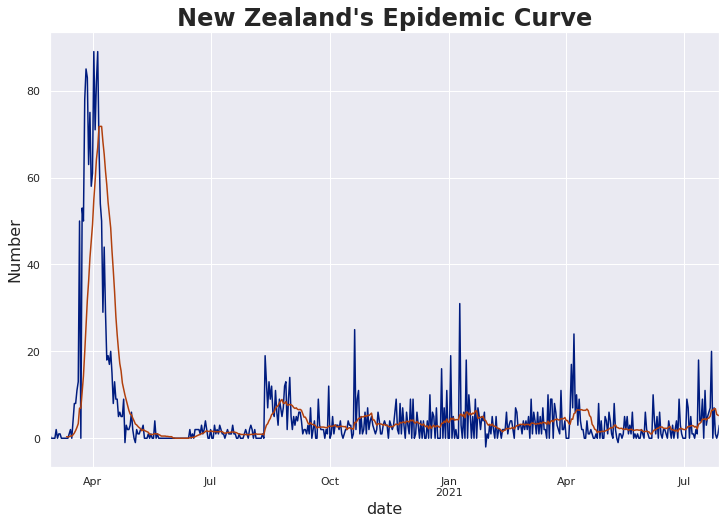

In [ ]:
ax_dt=nz_df['new_cases'].plot(kind='line',figsize=(12,8),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("New Zealand's Epidemic Curve",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );
nz_df['new_cases'].rolling(window=14).mean().plot()

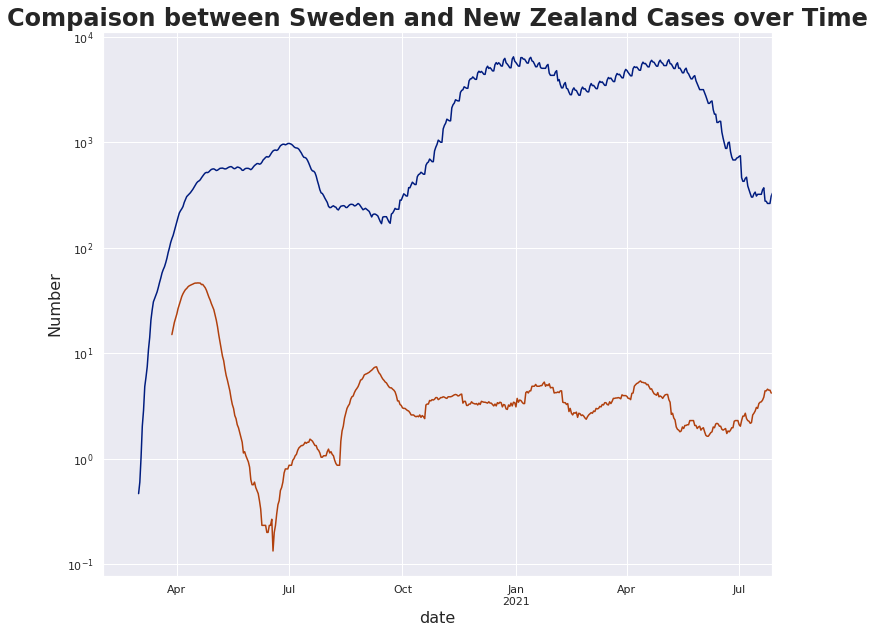

In [ ]:
ax_d=sweden_df['new_cases'].rolling(window=30).mean().plot(figsize=(12,10),logy=True)
ax_d.set_title("Compaison between Sweden and New Zealand Cases over Time",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_d.set_xlabel('Date',fontsize = 16, )
ax_d.set_ylabel('Number',fontsize = 16)
ax_d.set_xticklabels(grouped_dates_sum.index, rotation=45 );
nz_df['new_cases'].rolling(window=30).mean().plot(logy=True)

Vaccinations

In [ ]:
# Get data from 1st of January, 2021 
vax_df =grouped_dates_sum.loc['2021-01-01':]

vax_df.head()



,total_cases,new_cases,total_deaths,new_deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,total_vaccinations,people_vaccinated,people_fully_vaccinated,new_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population,population_density,median_age,gdp_per_capita,extreme_poverty,hospital_beds_per_thousand,human_development_index
date,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01-01,84137930.0,555114.0,1890493.0,10033.0,3073190.1,22723.9,57007.8,333.7,258970.0,9119.9,0.0,1653614.0,1652003.0,1170.0,119013.0,18.9,18.9,0.0,9866.6,7756292078.0,63874.5,5473.5,3422875.6,1715.6,498.2,133.0
2021-01-02,84727734.0,589804.0,1898641.0,8148.0,3089882.2,16692.1,57311.5,303.8,262366.0,9275.3,0.0,6910781.0,6908884.0,1469.0,176236.0,22.2,22.2,0.0,9873.6,7756292078.0,63874.5,5473.5,3422875.6,1715.6,498.2,133.0
2021-01-03,85255139.0,527405.0,1906097.0,7456.0,3107736.3,17854.2,57633.9,322.4,268807.0,9558.6,195784.3,3519791.0,3517889.0,1474.0,223434.0,25.0,25.0,0.0,9898.1,7756292078.0,63874.5,5473.5,3422875.6,1715.6,498.2,133.0
2021-01-04,85808989.0,553850.0,1916362.0,10265.0,3131598.3,23862.0,58221.9,588.0,288630.0,10096.2,0.0,7213749.0,7164499.0,1576.0,368033.0,26.9,26.6,0.0,9900.9,7756292078.0,63874.5,5473.5,3422875.6,1715.6,498.2,133.0
2021-01-05,86549120.0,740131.0,1931882.0,15520.0,3163448.5,31850.2,58829.4,607.5,290470.0,9999.5,0.0,8757745.0,7923071.0,1932.0,742048.0,38.8,30.3,0.0,9850.9,7756292078.0,63874.5,5473.5,3422875.6,1715.6,498.2,133.0


Text(0, 0.5, 'Number')

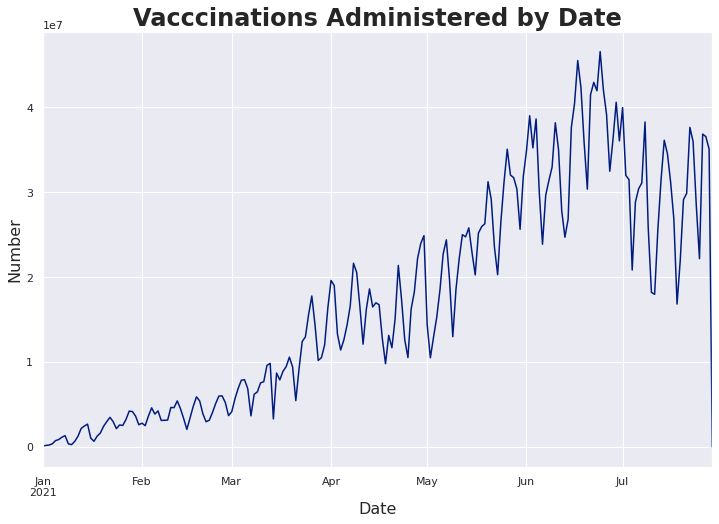

In [ ]:
ax_vx=vax_df['new_vaccinations'].plot(kind='line',figsize=(12,8))

ax_vx.set_title("Vacccinations Administered by Date",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_vx.set_xlabel('Date',fontsize = 16, )
ax_vx.set_ylabel('Number',fontsize = 16)

Text(0, 0.5, 'Number')

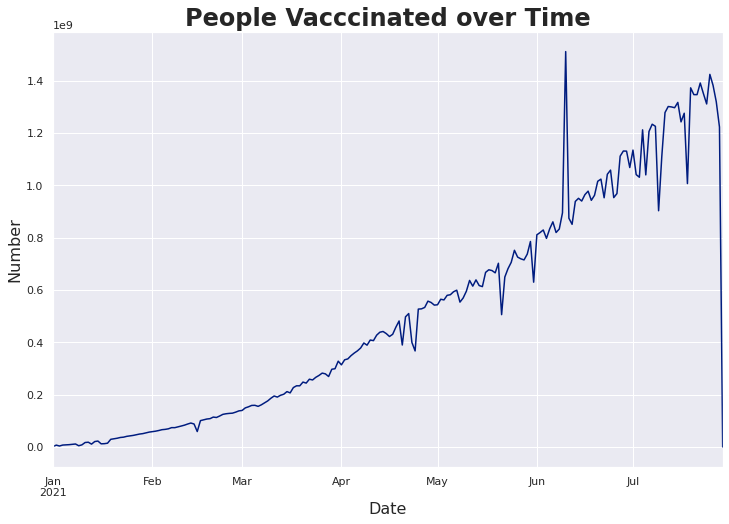

In [ ]:
ax_vx=vax_df['people_vaccinated'].plot(kind='line',figsize=(12,8))

ax_vx.set_title("People Vacccinated over Time",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_vx.set_xlabel('Date',fontsize = 16, )
ax_vx.set_ylabel('Number',fontsize = 16)

In [ ]:
country_vax_df= country_group.sum().sort_values(by='total_vaccinations_per_hundred',ascending=False)
#country_vax_df= country_group.sum().sort_values(by='total_vaccinations',ascending=False)
country_vax_df = country_vax_df.rename(columns={'new_cases':'cases'})
country_vax_df = country_vax_df.rename(columns={'new_deaths':'deaths'})
country_vax_df = country_vax_df.rename(columns={'new_vaccinations':'vaccinations_administered'})
country_vax_df.head(5)

,total_cases,cases,total_deaths,deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,total_vaccinations,people_vaccinated,people_fully_vaccinated,vaccinations_administered,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population,population_density,median_age,gdp_per_capita,extreme_poverty,hospital_beds_per_thousand,human_development_index
country,,,,,,,,,,,,,,,,,,,,,,,,,,
Israel,203961686.0,867240.0,1560418.0,6462.0,23564290.9,100194.8,180279.7,746.6,385227.0,44506.4,45033.0,1826493477.0,994669962.0,831823515.0,11121798.0,21102.1,11491.8,9610.3,32467.0,4552814566.0,211770.8,16095.6,17427600.3,263.0,1572.7,483.4
United Arab Emirates,121320107.0,676251.0,396516.0,1934.0,12266451.0,68374.5,40091.0,195.5,0.0,0.0,0.0,1718574918.0,145302314.0,125166423.0,14471746.0,17376.2,1469.1,1265.5,29603.2,5410048800.0,61505.8,18598.0,36809535.2,0.0,656.4,486.8
Gibraltar,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5201626.0,2971697.0,2229396.0,66973.0,15439.2,8820.5,6617.2,0.0,6670818.0,684505.8,0.0,0.0,0.0,0.0,0.0
Malta,6429839.0,33995.0,87731.0,423.0,14562335.4,76992.1,198693.6,958.0,0.0,0.0,1391.8,64623234.0,38970955.0,26570189.0,736694.0,14635.9,8826.1,6017.6,28768.6,237989521.0,783725.9,22853.6,19680681.1,107.8,2417.4,482.4
United Kingdom,1079431838.0,5797445.0,36640590.0,129718.0,15900653.7,85399.7,539737.0,1910.8,4660327.0,68649.3,480661.0,8843609319.0,5977255356.0,2866353963.0,81622182.0,13027.2,8804.8,4222.4,34945.0,36997872180.0,148729.4,22236.0,21665518.0,109.0,1384.3,507.9


In [ ]:
country_vax2_df= country_group.sum().sort_values(by='new_vaccinations',ascending=False)
country_vax2_df = country_vax2_df.rename(columns={'new_cases':'cases'})
country_vax2_df = country_vax2_df.rename(columns={'new_deaths':'deaths'})
country_vax2_df = country_vax2_df.rename(columns={'new_vaccinations':'vaccinations_administered'})
country_vax2_df.head(2)

,total_cases,cases,total_deaths,deaths,total_cases_per_million,new_cases_per_million,total_deaths_per_million,new_deaths_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,total_vaccinations,people_vaccinated,people_fully_vaccinated,vaccinations_administered,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,stringency_index,population,population_density,median_age,gdp_per_capita,extreme_poverty,hospital_beds_per_thousand,human_development_index
country,,,,,,,,,,,,,,,,,,,,,,,,,,
China,46355364.0,92322.0,2368028.0,4619.0,32206.3,64.2,1645.3,3.2,0.0,0.0,0.0,88671261700.0,622000000.0,223299000.0,1520789000.0,6160.6,43.2,15.5,39260.6,797385370796.0,81811.4,21439.8,8481026.4,387.8,2404.4,421.6
India,5038143958.0,31528114.0,67843283.0,422662.0,3650817.3,22846.4,49161.6,306.3,0.0,0.0,0.0,28044968738.0,22764807358.0,5280161380.0,424382721.0,2032.2,1649.6,382.6,38622.7,753482394210.0,245928.8,15397.2,3508964.0,11575.2,289.4,352.2


Text(0, 0.5, 'Population (natural log)')

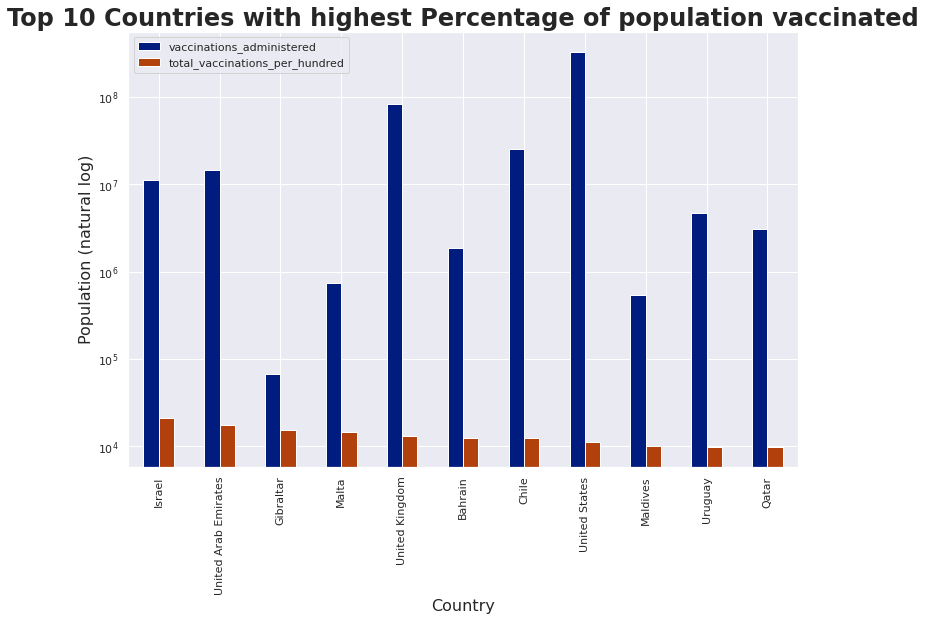

In [ ]:
ax_ct=country_vax_df.iloc[:11][['vaccinations_administered','total_vaccinations_per_hundred']].plot(kind='bar',figsize=(12,8),logy=True)

ax_ct.set_title("Top 10 Countries with highest Percentage of population vaccinated",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_ct.set_xlabel('Country',fontsize = 16, )
ax_ct.set_ylabel('Population (natural log)',fontsize = 16)
#ax_cont.set_xticklabels(vax_df.index, rotation=45 );

Comparison between people who got one vaccination and fully vaccinated in countries with most vaccinated per hundred.

Text(0, 0.5, 'Population (natural log)')

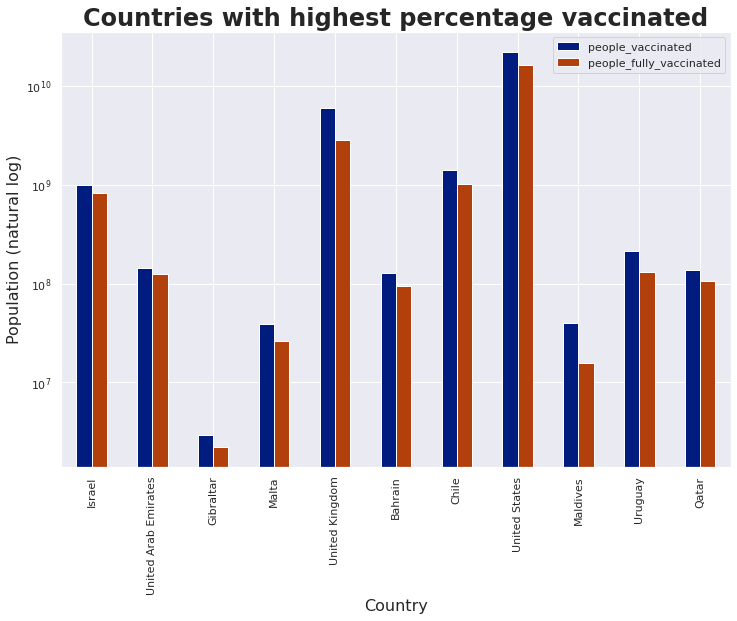

In [ ]:
ax_ct=country_vax_df.iloc[:11][['people_vaccinated','people_fully_vaccinated']].plot(kind='bar',figsize=(12,8),logy=True)

ax_ct.set_title("Countries with highest percentage vaccinated",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_ct.set_xlabel('Country',fontsize = 16, )
ax_ct.set_ylabel('Population (natural log)',fontsize = 16)
#ax_cont.set_xticklabels(vax_df.index, rotation=45 );

Comparison between people who got one vaccination and fully vaccinated in countries with most vaccinations administered.

Text(0, 0.5, 'Population (natural log)')

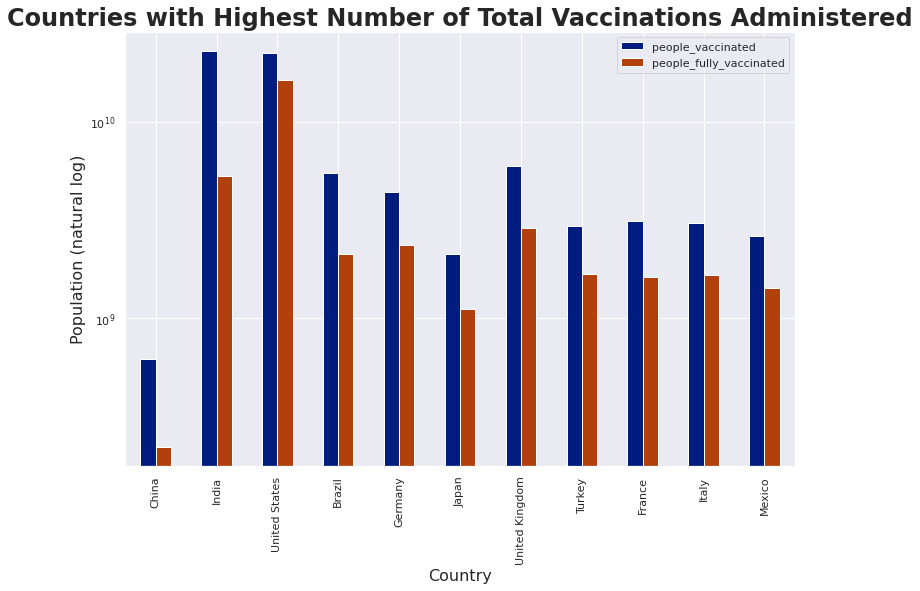

In [ ]:
ax_ct=country_vax2_df.iloc[:11][['people_vaccinated','people_fully_vaccinated']].plot(kind='bar',figsize=(12,8),logy=True)

ax_ct.set_title("Countries with Highest Number of Total Vaccinations Administered",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_ct.set_xlabel('Country',fontsize = 16, )
ax_ct.set_ylabel('Population (natural log)',fontsize = 16)
#ax_cont.set_xticklabels(vax_df.index, rotation=45 );

Text(0, 0.5, 'Number')

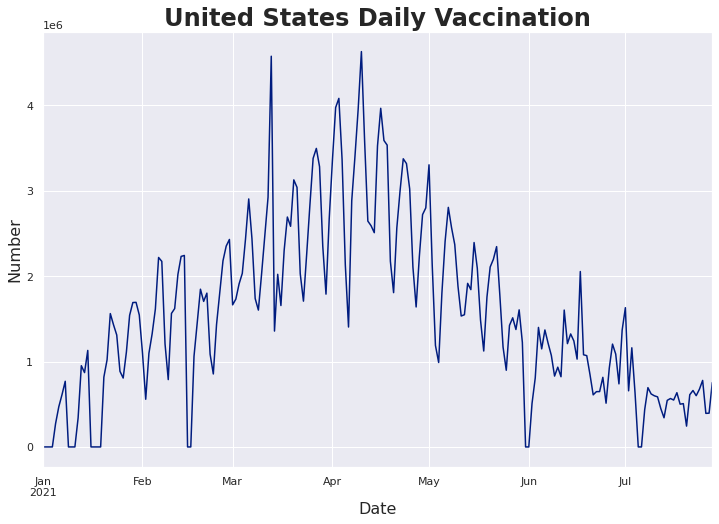

In [ ]:
ax_dt=usa_df.loc['2021-01-01':]['new_vaccinations'].plot(kind='line',figsize=(12,8),logy=False)

ax_dt.set_title("United States Daily Vaccination",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)

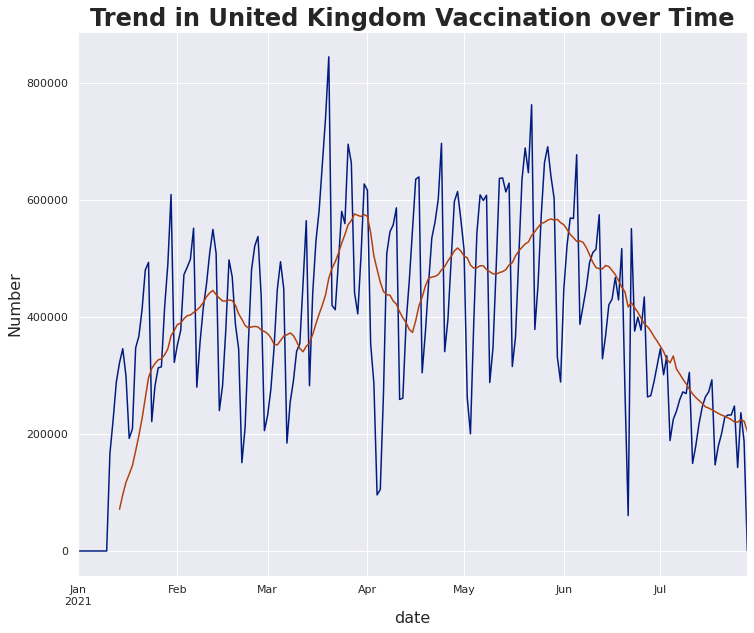

In [ ]:
ax_dt=uk_df.loc['2021-01-01':]['new_vaccinations'].plot(kind='line',figsize=(12,10),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("Trend in United Kingdom Vaccination over Time",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );
uk_df.loc['2021-01-01':]['new_vaccinations'].rolling(window=14).mean().plot()

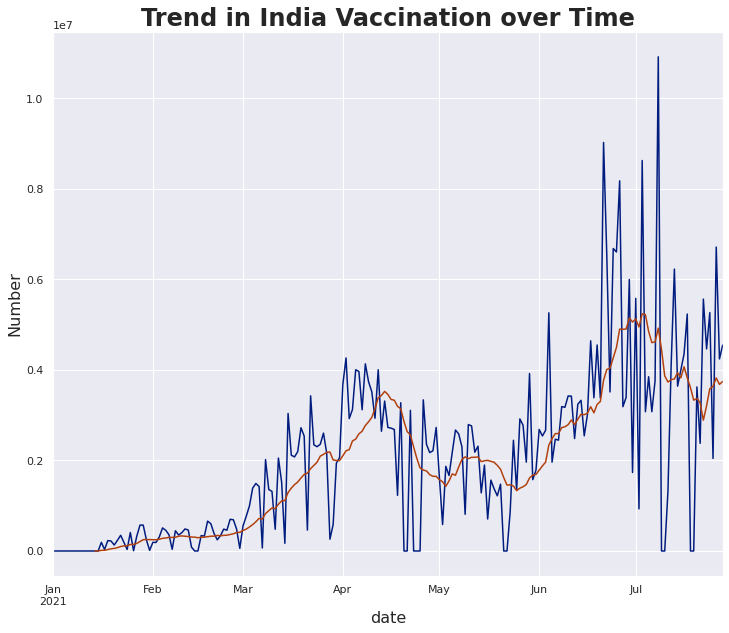

In [ ]:
ax_dt=ind_df.loc['2021-01-01':]['new_vaccinations'].plot(kind='line',figsize=(12,10),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("Trend in India Vaccination over Time",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );
ind_df.loc['2021-01-01':]['new_vaccinations'].rolling(window=14).mean().plot()

Text(0, 0.5, 'Number')

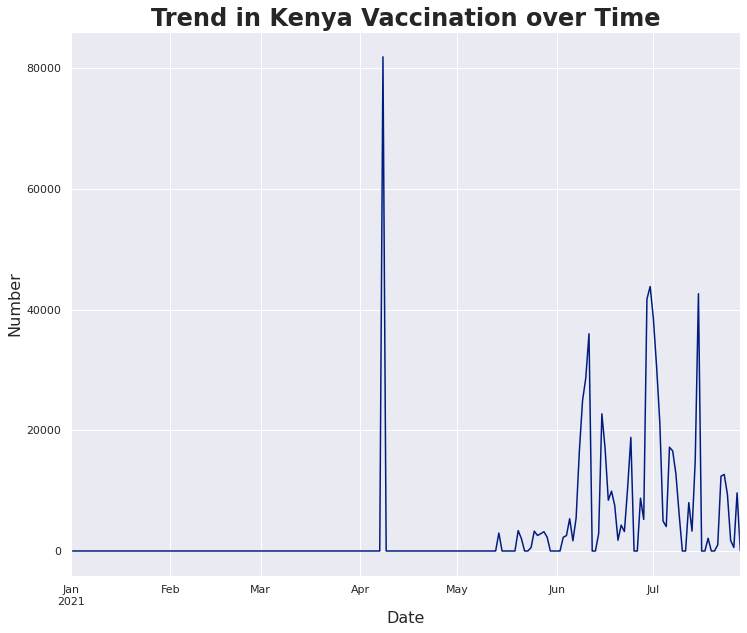

In [ ]:
ax_dt=ke_df.loc['2021-01-01':]['new_vaccinations'].plot(kind='line',figsize=(12,10),logy=False)
#ax_dt = sns.lineplot(x=grouped_dates_df.index, y="new_cases", hue='total_cases', data=grouped_dates_df)
#ax_dt=grouped_dates_df.plot(x= grouped_dates_df, y =['total_cases','new_cases'],kind='line',figsize=(15,10),logy=False)
ax_dt.set_title("Trend in Kenya Vaccination over Time",fontdict= { 'fontsize': 24, 'fontweight':'bold'})
ax_dt.set_xlabel('Date',fontsize = 16, )
ax_dt.set_ylabel('Number',fontsize = 16)
#ax_cont.set_xticklabels(grouped_dates_df.index, rotation=45 );

## Prediction of daily Vaccination in United states.
Our aim is to forecast the number of new vaccinations to be administered in the next * n* number of days. This will help in reource allocation for manufacturing companies,suppliers, health personel, government.

We are dealing with time series data.       
 Time series data is a collection of quantities that are assembled over even intervals in time and ordered chronologically.     
 Our data is collected daily over a period of six months.

#### Using Statistical Models.



In [ ]:
# Time series data of daily vaccinations administered.
usa_vax = usa_df.loc['2021-01-05':][['new_vaccinations']]
# Create a dataframe
usa_vax= pd.DataFrame(usa_vax)
usa_vax = usa_vax.rename(columns={'new_vaccinations':'vaccinations_administered'})

usa_vax.head()

,vaccinations_administered
date,
2021-01-05,273209.0
2021-01-06,470328.0
2021-01-07,612621.0
2021-01-08,768813.0
2021-01-09,0.0


In [ ]:
usa_vax.describe()

,vaccinations_administered
count,205.0
mean,1603167.2
std,1020571.8
min,0.0
25%,808036.0
50%,1512303.0
75%,2231745.0
max,4629928.0


Distribution of Vaccinations administered.

Text(0.5, 1.0, 'Distribution of vaccinations administered per day')

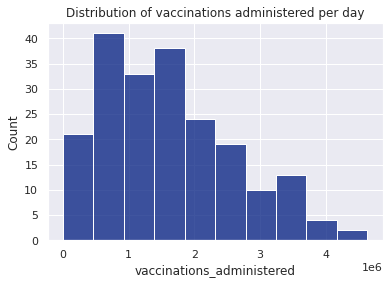

In [ ]:

vplt=sns.histplot(usa_vax['vaccinations_administered'])
vplt.set_title("Distribution of vaccinations administered per day")

In [ ]:
# Function to plot for stationarity test
def stationary_test_plot(series):
  ax=series.plot()
  ax.set_title("Stationarity Visualisayion",fontdict= { 'fontsize': 14, 'fontweight':'bold'})
  ax.set_xlabel('Date',fontsize = 12, )
  ax.set_ylabel('Number',fontsize = 12)
  #Plotting the moving average
  series.rolling(window=7).mean().plot()
  #Plotting the moving standard deviation.
  series.rolling(window=7).std().plot()
  

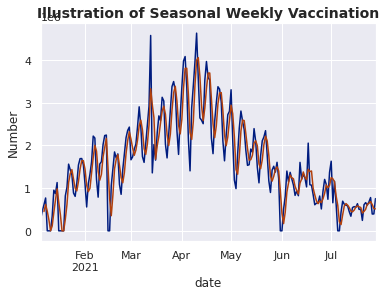

In [ ]:
# Plotting new vaccinations over time
ax=usa_vax.loc[:'2021-07-28']['vaccinations_administered'].plot()
ax.set_title("Illustration of Seasonal Weekly Vaccination",fontdict= { 'fontsize': 14, 'fontweight':'bold'})
ax.set_xlabel('Date',fontsize = 12, )
ax.set_ylabel('Number',fontsize = 12)
#Plotting the moving average
usa_vax['vaccinations_administered'].rolling(window=3).mean().plot()
#Plotting the moving standard deviation.
#usa_vax['vaccinations_administered'].rolling(window=3).std().plot()

- There's an upward trend between January and May with peaks in mid-March and mid-April followed by a downward trend from May to June.
- The mean is not constant.
- The variance is not constant.
- The series is not stationary.

In [ ]:
m1=round(usa_vax['vaccinations_administered'][:80].mean())
m2=round(usa_vax['vaccinations_administered'][81:].mean())
print("First mean is: ",m1, "and the Second mean is: ",m2)

First mean is:  1508482 and the Second mean is:  1649930


In [ ]:
v1=round(usa_vax['vaccinations_administered'][:80].var())
v2=round(usa_vax['vaccinations_administered'][81:].mean())
print("First variance is: ",v1, "and the Second variance is: ",v2)

First variance is:  807795157939 and the Second variance is:  1649930


In [ ]:
from statsmodels.tsa.stattools import adfuller
# Null hypothesis -- series is not stationary.

adf_test = adfuller(usa_vax['vaccinations_administered'].values)

# Get the p value -- if it is less than 0.05 reject the null hypothesis
p = adf_test[1]
print ('The P Value is: ',p)


The P Value is:  0.5723242177330471


In [ ]:
# Create afunction for the dickey fuller test.
def adfuller_test(sales):
    result=adfuller(sales)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("The series is stationary")
    else:
        print("The series is non-stationary ")


Difference the time series data to make it stationary

In [ ]:
usa_vax['diff_vaccinations']=usa_vax['vaccinations_administered'].diff()
usa_vax.dropna(axis=0,inplace=True)
usa_vax.tail(3)

,vaccinations_administered,diff_vaccinations
date,,
2021-07-26,393083.0,-385913.0
2021-07-27,395489.0,2406.0
2021-07-28,753984.0,358495.0


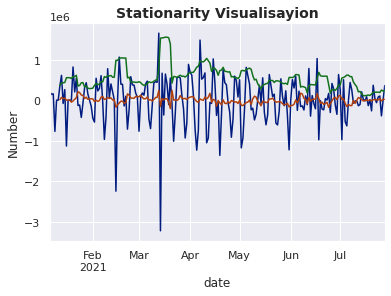

In [ ]:
stationary_test_plot(usa_vax['diff_vaccinations'])

In [ ]:
adfuller_test(usa_vax['diff_vaccinations'])

ADF Test Statistic : -3.008376842900724
p-value : 0.03411947947141496
#Lags Used : 15
Number of Observations Used : 188
The series is stationary


ARIMA - Autoregressive (p) Integrated(d) Moving Average (q)

The autoregressive model          

Identification of an AR model is often best done with the PACF.
- For an AR model, the theoretical PACF “shuts off” past the order of the model. 
- The phrase “shuts off” means that in theory the partial autocorrelations are equal to 0 beyond that point. Put another way, the number of non-zero partial autocorrelations gives the order of the AR model. 
- By the “order of the model” we mean the most extreme lag of x that is used as a predictor.

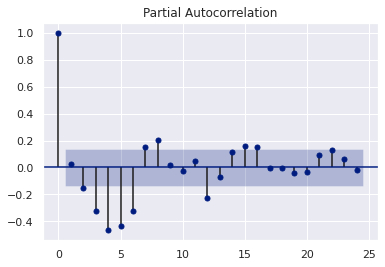

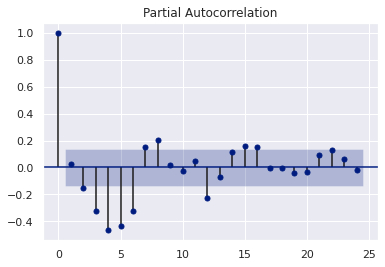

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
#plot_pacf identifies patameter p
plot_pacf(usa_vax['diff_vaccinations'])

The Moving Average (MA) Model         

dentification of an MA model is often best done with the ACF rather than the PACF.

- For an MA model, the theoretical PACF does not shut off, but instead tapers toward 0 in some manner.
-  A clearer pattern for an MA model is in the ACF. The ACF will have non-zero autocorrelations only at lags involved in the model.

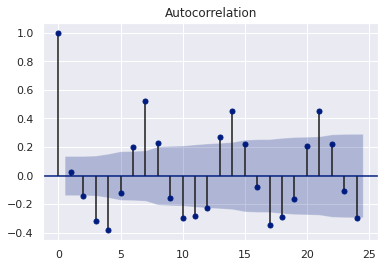

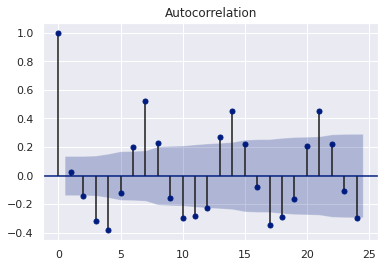

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf

#plot_acf identifies patameter q
plot_acf(usa_vax['diff_vaccinations'])

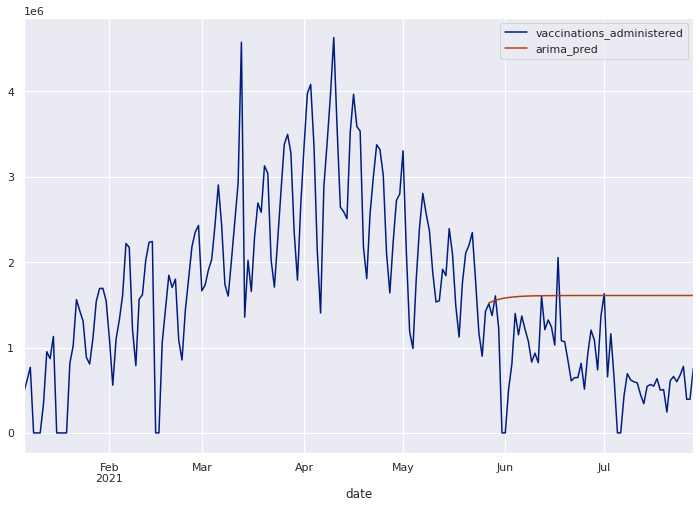

In [ ]:
from statsmodels.tsa.arima_model import ARIMA

model = ARIMA(usa_vax['vaccinations_administered'], order=(1,0,1))
arima_model_fit = model.fit()

usa_vax['arima_pred']=arima_model_fit.predict(start=141,end=204,dynamic=True)
usa_vax[['vaccinations_administered','arima_pred']].plot(figsize=(12,8))

Seasonal Arima

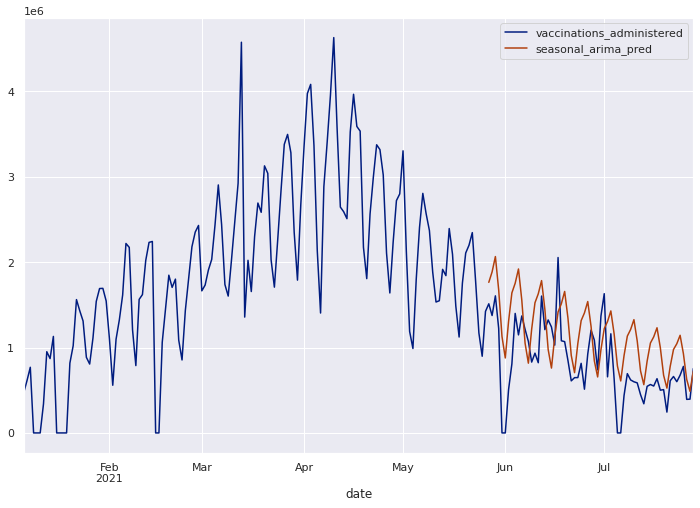

In [ ]:
import statsmodels.api as sm

model=sm.tsa.statespace.SARIMAX(usa_vax['vaccinations_administered'],order=(1, 0, 1),seasonal_order=(1,0,1,7))
sarima_model_fit=model.fit()

usa_vax['seasonal_arima_pred']=sarima_model_fit.predict(start=141,end=204,dynamic=True)
usa_vax[['vaccinations_administered','seasonal_arima_pred']].plot(figsize=(12,8))

In [ ]:
arima_df = usa_vax.dropna()
from sklearn.metrics import mean_squared_error as MSE

print("ARIMA")
  # RMSE Computation
rmse = np.sqrt(MSE(arima_df['vaccinations_administered'], arima_df['arima_pred']))
print("Root Mean Squared Eroor : % f" %(rmse))

  # Calculate mean absolute percentage error (MAPE)
mape = (rmse / arima_df['seasonal_arima_pred'].to_numpy())
  # Calculate and display accuracy
err = np.mean(mape[~np.isinf(mape)])
print('Error rate:',err)
accuracy = (1-(np.mean(mape[~np.isinf(mape)])))*100
print('Accuracy: ',round(accuracy,2))

ARIMA
Root Mean Squared Eroor :  890705.005645
Error rate: 0.8635148438035611
Accuracy:  13.65


In [ ]:

from sklearn.metrics import mean_squared_error as MSE

print("Seasonal ARIMA")
  # RMSE Computation
rmse = np.sqrt(MSE(arima_df['vaccinations_administered'], arima_df['seasonal_arima_pred']))
print("Root Mean Squared Eroor : % f" %(rmse))

  # Calculate mean absolute percentage error (MAPE)
mape = (rmse / arima_df['seasonal_arima_pred'].to_numpy())
  # Calculate and display accuracy
err = np.mean(mape[~np.isinf(mape)])
print('Error rate:',err)
accuracy = (1-(np.mean(mape[~np.isinf(mape)])))*100
print('Accuracy: ',round(accuracy,2))

Seasonal ARIMA
Root Mean Squared Eroor :  491661.185743
Error rate: 0.47665245992831384
Accuracy:  52.33


Feature Selection

In [ ]:
# A list of potential features
usa_df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 554 entries, 2020-01-22 to 2021-07-28
Data columns (total 29 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   iso_code                             554 non-null    object 
 1   continent                            554 non-null    object 
 2   country                              554 non-null    object 
 3   total_cases                          554 non-null    float64
 4   new_cases                            554 non-null    float64
 5   total_deaths                         554 non-null    float64
 6   new_deaths                           554 non-null    float64
 7   total_cases_per_million              554 non-null    float64
 8   new_cases_per_million                554 non-null    float64
 9   total_deaths_per_million             554 non-null    float64
 10  new_deaths_per_million               554 non-null    float64
 11  hosp_patients

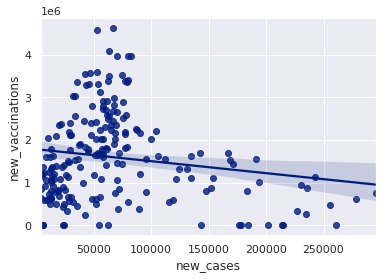

In [ ]:
# Plotting new vaccinations against new cases
sns.regplot(x='new_cases', y='new_vaccinations', data= usa_df.loc['2021-01-04':])

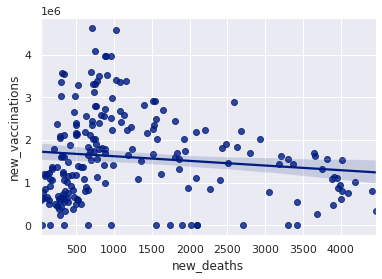

In [ ]:
# Plotting new vaccinations against new cases
sns.regplot(x='new_deaths', y='new_vaccinations', data= usa_df.loc['2021-01-04':])

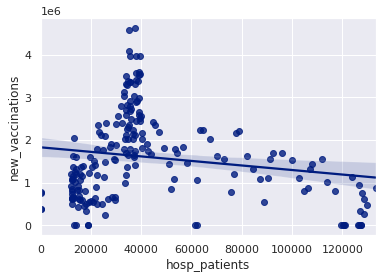

In [ ]:
# Plotting new vaccinations against hospitalised patienys.
sns.regplot(x='hosp_patients', y='new_vaccinations', data= usa_df.loc['2021-01-04':])

In [ ]:
usa_vax = usa_df.loc['2021-01-04':][['new_cases','new_deaths','hosp_patients','new_vaccinations']]

# Create a dataframe
usa_vax= pd.DataFrame(usa_vax)
usa_vax

,new_cases,new_deaths,hosp_patients,new_vaccinations
date,,,,
2021-01-04,184005.0,2094.0,127396.0,0.0
2021-01-05,235042.0,3690.0,128826.0,273209.0
2021-01-06,255637.0,3892.0,129769.0,470328.0
2021-01-07,278337.0,4004.0,128782.0,612621.0
2021-01-08,295257.0,4098.0,127854.0,768813.0
...,...,...,...,...
2021-07-24,27395.0,115.0,29596.0,676050.0
2021-07-25,16008.0,56.0,0.0,778996.0
2021-07-26,89096.0,271.0,0.0,393083.0


In [ ]:
# Calculate the correlation coefficient
x = usa_vax['new_cases']
d = usa_vax['new_deaths']
h = usa_vax['hosp_patients']
y = usa_vax['new_vaccinations']

r1 = x.corr(y)
r2= d.corr(y)
r3= h.corr(y)
print ("Cases corr coefficient: ",r1)
print ("Deaths corr coefficient: ",r2)
print ("Hospitalised patients corr coefficient: ",r3)

Cases corr coefficient:  -0.16520956842380316
Deaths corr coefficient:  -0.12404115574846716
Hospitalised patients corr coefficient:  -0.17521577183857312


Correlation coefficient of -0.17 shows that theres a moderate correlation between the new_vases and new_vaccinations. The more the number of vaccinations administered the fewer the number of cases and vice versa.             
Correlation coefficient of -0.12 shows that theres a moderate correlation between the new_deaths and new_vaccinations. The more the number of vaccinations administered the fewer the number of deaths and vice versa.
Correlation coefficient of -0.18 shows that theres a moderate correlation between the hospiyalised patients and new_vaccinations. The more the number of vaccinations administered the fewer the number of hospitalised patirnts and vice versa.




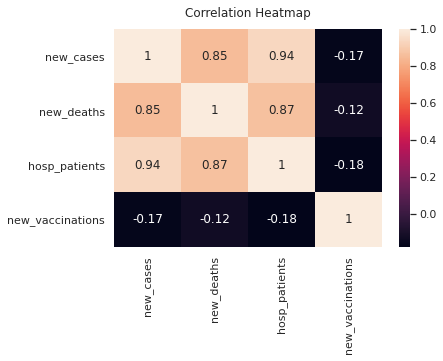

In [ ]:
heatmap= sns.heatmap(usa_vax.corr(), annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

Due to the strong positive correlation one feature has to be dropped.

In [ ]:
# Add a new id column to represent dates numerically.
usa_vax.reset_index(inplace=True)
usa_vax['id']=usa_vax.index

#usa_vax.index=usa_vax.index.to_period('D').size
usa_vax=usa_vax.drop(usa_vax.index[0],axis=0)

#usa_vax['id']=range(1,170)
usa_vax=usa_vax.reindex(columns=['date','id','hosp_patients','new_cases','new_vaccinations'])
usa_vax=usa_vax.set_index('date')
usa_vax = usa_vax.rename(columns={'hosp_patients':'hospital_admissions'})
usa_vax = usa_vax.rename(columns={'new_cases':'daily_cases'})
usa_vax = usa_vax.rename(columns={'new_vaccinations':'vaccinations_administered'})
usa_vax

,id,hospital_admissions,daily_cases,vaccinations_administered
date,,,,
2021-01-05,1,128826.0,235042.0,273209.0
2021-01-06,2,129769.0,255637.0,470328.0
2021-01-07,3,128782.0,278337.0,612621.0
2021-01-08,4,127854.0,295257.0,768813.0
2021-01-09,5,126384.0,260967.0,0.0
...,...,...,...,...
2021-07-24,201,29596.0,27395.0,676050.0
2021-07-25,202,0.0,16008.0,778996.0
2021-07-26,203,0.0,89096.0,393083.0


In [ ]:
usa_vax.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 205 entries, 2021-01-05 to 2021-07-28
Data columns (total 4 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   id                         205 non-null    int64  
 1   hospital_admissions        205 non-null    float64
 2   daily_cases                205 non-null    float64
 3   vaccinations_administered  205 non-null    float64
dtypes: float64(3), int64(1)
memory usage: 8.0 KB


Distribution and checking for outliers in features.

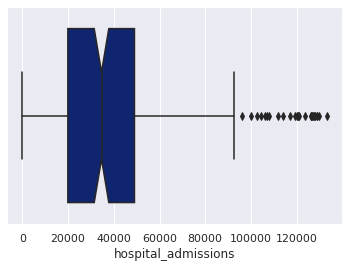

In [ ]:
sns.boxplot(usa_vax['hospital_admissions'],notch ='True')

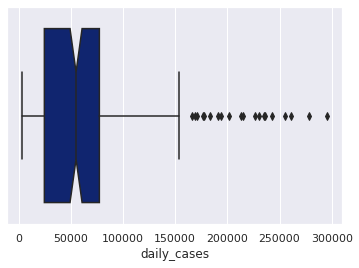

In [ ]:
sns.boxplot(usa_vax['daily_cases'],notch ='True')

In [ ]:
usa_vax.describe()

,id,hospital_admissions,daily_cases,vaccinations_administered
count,205.0,205.0,205.0,205.0
mean,103.0,43577.8,66952.2,1603167.2
std,59.3,33357.2,59924.0,1020571.8
min,1.0,0.0,3697.0,0.0
25%,52.0,19883.0,24699.0,808036.0
50%,103.0,34618.0,55077.0,1512303.0
75%,154.0,49042.0,77404.0,2231745.0
max,205.0,133214.0,295257.0,4629928.0


Feature Engineering

In [ ]:
# Stationary vaccination data
usa_vax['diff_vaccinations']=usa_vax['vaccinations_administered'].diff(periods=1)

# Adding lag variable
usa_vax['prev_day_vaccination']=usa_vax['vaccinations_administered'].shift(1)
usa_vax['prev_3_day_vaccination']=usa_vax['vaccinations_administered'].shift(3)
usa_vax['prev_6_day_vaccination']=usa_vax['vaccinations_administered'].shift(6)

# Adding smoothed variable
usa_vax['3_day_average_vaccination']=usa_vax['vaccinations_administered'].rolling(window=3).mean()

# Adding lag variable for the next day
usa_vax['next_day_vaccinations']=usa_vax['vaccinations_administered'].shift(-1)

In [ ]:

usa_vax=usa_vax.dropna(axis=0)
usa_vax.tail()

,id,hospital_admissions,daily_cases,vaccinations_administered,diff_vaccinations,prev_day_vaccination,prev_3_day_vaccination,prev_6_day_vaccination,3_day_average_vaccination,next_day_vaccinations
date,,,,,,,,,,
2021-07-23,200,29607.0,118797.0,600157.0,-60741.0,660898.0,243940.0,635290.0,624182.7,676050.0
2021-07-24,201,29596.0,27395.0,676050.0,75893.0,600157.0,611493.0,500910.0,645701.7,778996.0
2021-07-25,202,0.0,16008.0,778996.0,102946.0,676050.0,660898.0,507076.0,685067.7,393083.0
2021-07-26,203,0.0,89096.0,393083.0,-385913.0,778996.0,600157.0,243940.0,616043.0,395489.0
2021-07-27,204,0.0,70740.0,395489.0,2406.0,393083.0,676050.0,611493.0,522522.7,753984.0


prepare data

In [ ]:
features = usa_vax[['id','daily_cases','hospital_admissions','vaccinations_administered','diff_vaccinations','prev_day_vaccination','prev_6_day_vaccination','prev_3_day_vaccination','3_day_average_vaccination']].to_numpy()
labels = np.array(usa_vax['next_day_vaccinations']).reshape(-1,1)

In [ ]:
features

array([[7.00000000e+00, 2.14664000e+05, 1.27585000e+05, ...,
        2.73209000e+05, 7.68813000e+05, 0.00000000e+00],
       [8.00000000e+00, 2.26967000e+05, 1.27030000e+05, ...,
        4.70328000e+05, 0.00000000e+00, 1.13272000e+05],
       [9.00000000e+00, 2.30301000e+05, 1.26529000e+05, ...,
        6.12621000e+05, 0.00000000e+00, 4.30380000e+05],
       ...,
       [2.02000000e+02, 1.60080000e+04, 0.00000000e+00, ...,
        5.07076000e+05, 6.60898000e+05, 6.85067667e+05],
       [2.03000000e+02, 8.90960000e+04, 0.00000000e+00, ...,
        2.43940000e+05, 6.00157000e+05, 6.16043000e+05],
       [2.04000000e+02, 7.07400000e+04, 0.00000000e+00, ...,
        6.11493000e+05, 6.76050000e+05, 5.22522667e+05]])

Split into train and test

In [ ]:
# Using Skicit-learn to split data into training and testing sets
from sklearn.model_selection import train_test_split

# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.10, shuffle=False)

In [ ]:
#Function to visualise the model
def visualize_model (prediction):
  plt.scatter(x=range(len(test_labels)),y=test_labels, alpha=0.6,c='darkblue', label='Actual Values')
  plt.plot(prediction, marker='o', alpha=0.8, c='orange', label='Model Predictions')
  plt.legend(loc='upper left')
  plt.show()

In [ ]:
# Function to evaluate the models.
def evaluate_model(prediction):
  
  from sklearn.metrics import mean_squared_error as MSE

  # RMSE Computation
  rmse = np.sqrt(MSE(test_labels, prediction))
  print("Root Mean Squared Error : % f" %(rmse))

  # Calculate mean absolute percentage error (MAPE)
  mape = (rmse / test_labels)
  
  # Calculate and display accuracy
  err = np.mean(mape[~np.isinf(mape)])
  print('Error rate:',round(err,3))
  accuracy = (1-(np.mean(mape[~np.isinf(mape)])))*100
  print('Accuracy: ',round(accuracy,1))


Train the models

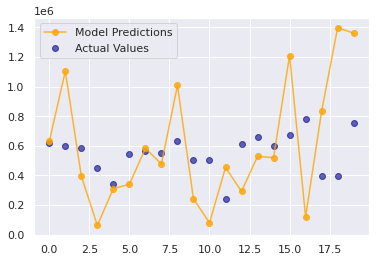

In [ ]:
from sklearn import linear_model

model = linear_model.LinearRegression()
model.fit(train_features,train_labels)
lreg_pred =model.predict(test_features)

visualize_model(lreg_pred)


In [ ]:
evaluate_model(lreg_pred)

Root Mean Squared Error :  407936.733309
Error rate: 0.799
Accuracy:  20.1


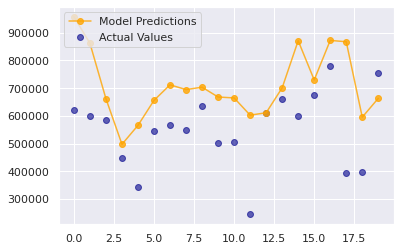

In [ ]:
# Import the model we are using
from sklearn.ensemble import RandomForestRegressor
# Instantiate model with 1000 decision trees
rf = RandomForestRegressor(n_estimators = 1000, random_state = 42)
# Train the model on training data
rf_fit=rf.fit(train_features, train_labels)
# Use the forest's predict method on the test data
rf_pred = rf_fit.predict(test_features)

visualize_model(rf_pred)

In [ ]:
evaluate_model(rf_pred)

Root Mean Squared Error :  205187.096688
Error rate: 0.402
Accuracy:  59.8


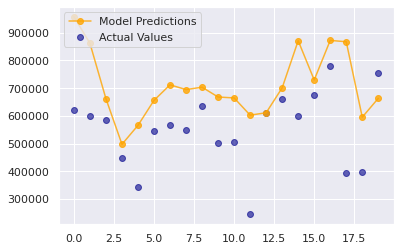

In [ ]:
# Import the model we are using
from sklearn.tree import DecisionTreeRegressor
# Instantiate model 
dtr = RandomForestRegressor(random_state = 42)
# Train the model on training data
dtr_fit=rf.fit(train_features, train_labels)
# Use the forest's predict method on the test data
dtr_pred = dtr_fit.predict(test_features)

visualize_model(dtr_pred)

In [ ]:
print("Decision Tree")
evaluate_model(dtr_pred)

Decision Tree
Root Mean Squared Error :  205187.096688
Error rate: 0.402
Accuracy:  59.8


In [ ]:
import xgboost as xg

# Instantiation
xgb_r = xg.XGBRegressor(n_estimators=1000, max_depth=7, eta=0.1, subsample=0.7, colsample_bytree=0.8)
  
# Fitting the model
xgb_r.fit(train_features, train_labels)
  
# Make predictions
xgb_pred = xgb_r.predict(test_features)



[02:31:39] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


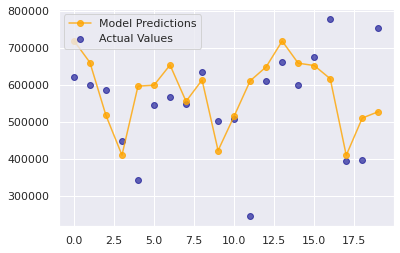

In [ ]:
visualize_model(xgb_pred)

In [ ]:
evaluate_model(xgb_pred)

Root Mean Squared Error :  129726.349769
Error rate: 0.254
Accuracy:  74.6


In [ ]:
test_labels

array([[620612.],
       [598995.],
       [586244.],
       [449122.],
       [341466.],
       [545543.],
       [567174.],
       [549205.],
       [635290.],
       [500910.],
       [507076.],
       [243940.],
       [611493.],
       [660898.],
       [600157.],
       [676050.],
       [778996.],
       [393083.],
       [395489.],
       [753984.]])

In [ ]:
xgb_pred

array([719786.75, 660449.4 , 517309.47, 409753.  , 596564.8 , 599135.94,
       653763.25, 555358.4 , 613190.56, 422255.66, 515303.44, 610796.06,
       648717.8 , 718655.4 , 658678.3 , 652334.06, 616641.2 , 409384.1 ,
       510174.78, 527337.1 ], dtype=float32)

In [ ]:
finaldf=usa_vax[['vaccinations_administered','next_day_vaccinations']].tail(20)

finaldf['PREDICTED_next_day_vaccinations']=xgb_pred

finaldf.columns = ['Vaccinations_Administered','ACTUAL_next_day_vaccinations', 'PREDICTED_next_day_vaccinations']

finaldf

,Vaccinations_Administered,ACTUAL_next_day_vaccinations,PREDICTED_next_day_vaccinations
date,,,
2021-07-08,694333.0,620612.0,719786.8
2021-07-09,620612.0,598995.0,660449.4
2021-07-10,598995.0,586244.0,517309.5
2021-07-11,586244.0,449122.0,409753.0
2021-07-12,449122.0,341466.0,596564.8
2021-07-13,341466.0,545543.0,599135.9
2021-07-14,545543.0,567174.0,653763.2
2021-07-15,567174.0,549205.0,555358.4
2021-07-16,549205.0,635290.0,613190.6
